In [11]:
import numpy as np
from os import listdir
import matplotlib.pyplot as plt
from scipy import signal
from scipy.interpolate import interp1d
#import peakutils
from sklearn.preprocessing import StandardScaler,MinMaxScaler,label_binarize
from sklearn import preprocessing
import pywt
import csv
import scipy.signal
from scipy.fftpack import fft, fftfreq, ifft
# Import the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
# Import the Keras libraries and packages
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
import tensorflow as tf
# Feature Scaling
from sklearn.preprocessing import MinMaxScaler
%matplotlib inline

##__讀檔
class ECG:
    def __init__(self, path, id):
        self.id = id
        self.data_1 = [] #前測
        self.data_2 = [] #後測

        with open(path, 'r') as fp:
            all_lines = fp.readlines()
            self.data_1 = [int(i.replace('\n', ''))
                           for i in all_lines if i != '']
             
        try:
            path2 = path.replace('HealthCare', 'HealthCare2')[:-34] + listdir(path.replace('HealthCare', 'HealthCare2')[:-34])[0]
        except:
            path2 = ''
            print(f'{i}path2 not found')
        if path2 != '' :    
            with open(path2, 'r') as fp:
                all_lines = fp.readlines()
                self.data_2 = [int(i.replace('\n', ''))
                            for i in all_lines if i != '']
        


In [7]:
!pip list

Package                            Version
---------------------------------- -------------------
alabaster                          0.7.12
anaconda-client                    1.7.2
anaconda-navigator                 2.0.3
anaconda-project                   0.9.1
anyio                              2.2.0
appdirs                            1.4.4
argh                               0.26.2
argon2-cffi                        20.1.0
asn1crypto                         1.4.0
astroid                            2.5
astropy                            4.2.1
async-generator                    1.10
atomicwrites                       1.4.0
attrs                              20.3.0
autopep8                           1.5.6
Babel                              2.9.0
backcall                           0.2.0
backports.functools-lru-cache      1.6.4
backports.shutil-get-terminal-size 1.0.0
backports.tempfile                 1.0
backports.weakref                  1.0.post1
bcrypt                             3.2

In [10]:
!pip install tensorflow

  Created wheel for termcolor: filename=termcolor-1.1.0-py3-none-any.whl size=4829 sha256=700beea711c8bbaa109406374652b8b122c566fe62e2cff1a0cac434c9c3d31d
  Stored in directory: c:\users\user\appdata\local\pip\cache\wheels\a0\16\9c\5473df82468f958445479c59e784896fa24f4a5fc024b0f501
Successfully built termcolor


In [5]:
#!pip freeze > requirements.txt #---- 環境txt檔生成
!pip install -r requirements.txt

ERROR: Could not find a version that satisfies the requirement anaconda-navigator==1.9.12
ERROR: No matching distribution found for anaconda-navigator==1.9.12


In [12]:
path = 'HealthCare/'
ecg_data = {}
for index_i, i in enumerate(sorted(listdir(path))[1:]):
    print(index_i, path+i+'/ECG/'+listdir(path+i+'/ECG/')[0])
    ecg_data[index_i] = ECG(path+i+'/ECG/'+listdir(path+i+'/ECG/')[0], i)

0 HealthCare/0oIU49KgucebDQVLsbi9GaE4kCx1/ECG/Nordic_BMD_2020_04_17_17_21_11.txt
1 HealthCare/494LYL68exSsVz1MiEOVhXaLiWQ2/ECG/Nordic_BMD_2020_04_14_14_56_35.txt
2 HealthCare/5fIe2OT5kDPvCzvYRCbgEV44u8p2/ECG/Nordic_BMD_2020_04_14_14_17_57.txt
3 HealthCare/6dklfeWE6eUr9cmTkL9Efr0lbI72/ECG/Nordic_BMD_2020_04_16_17_44_33.txt
4 HealthCare/ALodKECP4LUQtfjGZvZF8OH9is02/ECG/Nordic_BMD_2020_04_13_16_41_07.txt
5 HealthCare/BnBR76PZhtMEyE9u8XDdTxh2IgO2/ECG/Nordic_BMD_2020_04_22_14_01_50.txt
6 HealthCare/C37mCvL6NaR2ecuhxAF7WHEhyYQ2/ECG/Nordic_BMD_2020_04_13_15_21_59.txt
7 HealthCare/CQc447ZB9naQoXZZ2GZNs3Y1bdE3/ECG/Nordic_BMD_2020_04_17_17_31_21.txt
8 HealthCare/CT5DcLSYJONqvO4GRfOjYTUpyGK2/ECG/Nordic_BMD_2020_04_13_16_52_22.txt
9 HealthCare/CopxNHhfFlTHl4vZ3eKBYh2wbN12/ECG/Nordic_BMD_2020_04_17_16_42_19.txt
10 HealthCare/Ge1rKvBRBbbmY16PNwQ0R3aedQH3/ECG/Nordic_BMD_2020_04_20_13_39_17.txt
11 HealthCare/HxKX18qrMhQ52kPQIxDnu9l39Xl1/ECG/Nordic_BMD_2020_04_16_17_10_17.txt
12 HealthCare/JrNpxzK77tdH

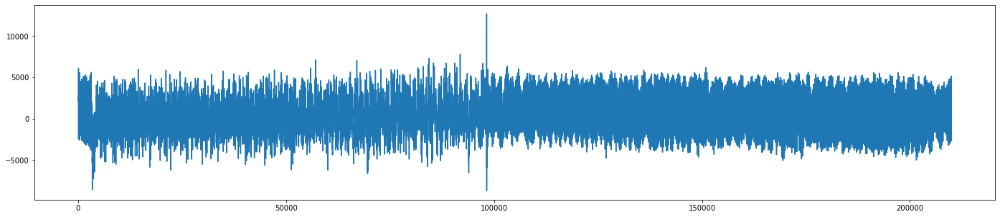

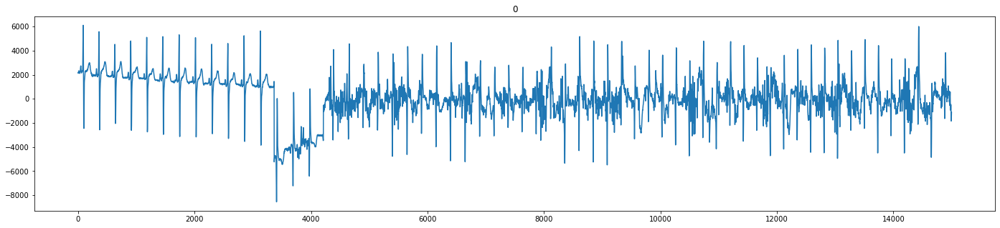

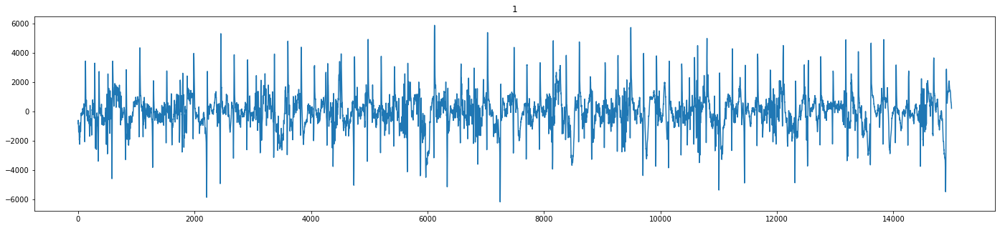

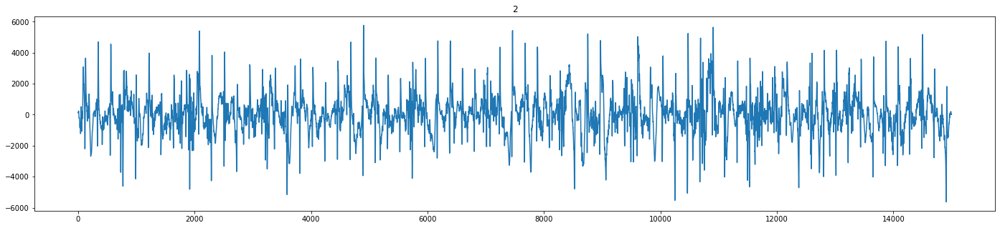

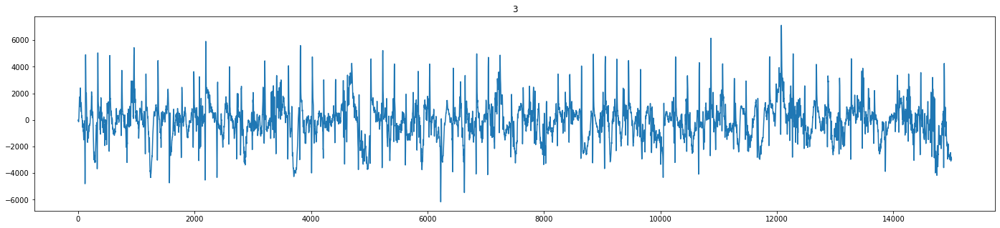

...

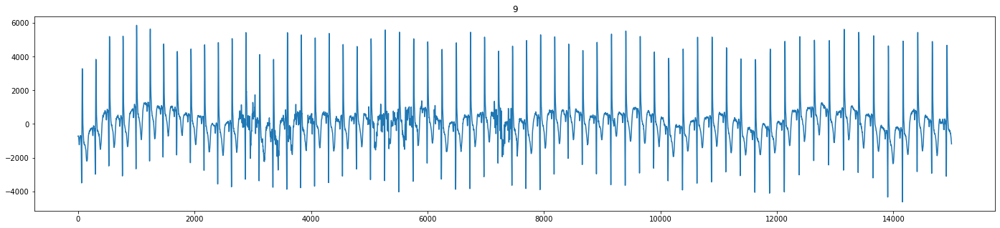

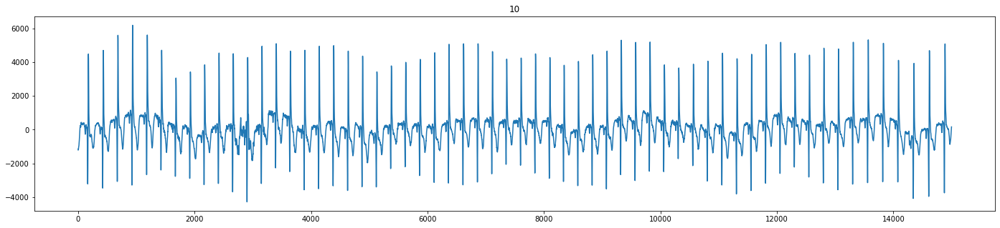

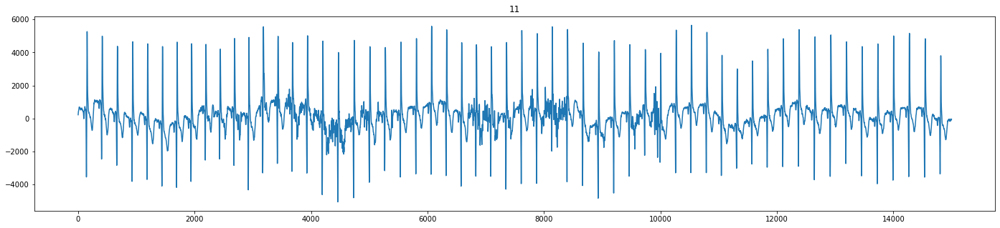

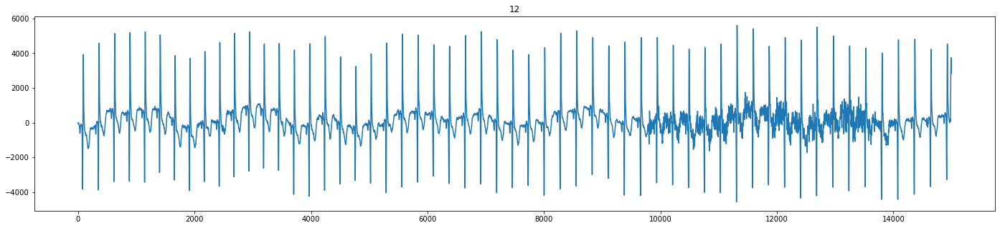

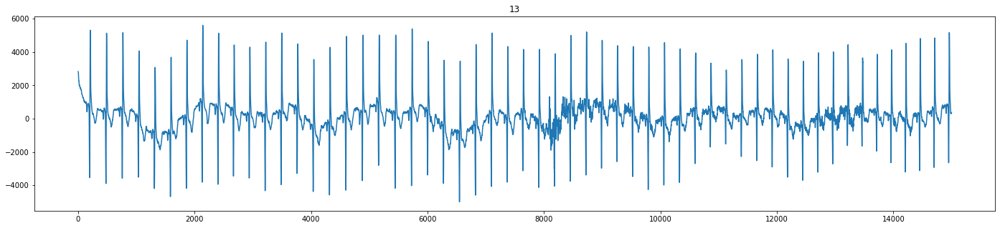

In [13]:
##_原始訊號
i = 16
plt.figure(figsize=(24,5))
plt.plot(ecg_data[i].data_2[0:210000])

count = 0

for j in range(0, 14):
    plt.figure(figsize=(24,5))
    plt.title(j)
    plt.plot(ecg_data[i].data_2[j*30*500:(j+1)*30*500]) #(0:180)：運動中 0-6  (180:420)：休息中 6-14    1-14   5-7不用
    #plt.figure(figsize=(24,5))
    #plt.plot(ecg_data[i].data_2[(j+)+*30*500:(j+)*30*500])

#ecg_motion = ecg_data[i].data_2[5*30*500:6*30*500]
#ecg_rest = ecg_data[i].data_2[7*30*500:8*30*500]

In [14]:
##-----------------------------------------------------------相關性分析
import math
def mean(x):
  return sum(x) / len(x)
def de_mean(x):
  x_bar = mean(x)
  return [x_i - x_bar for x_i in x]
# 輔助計算函式 dot product 、sum_of_squares
def dot(v, w):
  return sum(v_i * w_i for v_i, w_i in zip(v, w))
def sum_of_squares(v):
  return dot(v, v)
# 方差
def variance(x):
  n = len(x)
  deviations = de_mean(x)
  return sum_of_squares(deviations) / (n - 1)
# 標準差
def standard_deviation(x):
  return math.sqrt(variance(x))
def standard_deviation(x):
  return math.sqrt(variance(x))
def covariance(x, y):
  n = len(x)
  return dot(de_mean(x), de_mean(y)) / (n -1)
def correlation(x, y):
  stdev_x = standard_deviation(x)
  stdev_y = standard_deviation(y)
  if stdev_x > 0 and stdev_y > 0:
    return covariance(x, y) / stdev_x / stdev_y
  else:
    return 0

In [15]:
from scipy.signal import butter #---------------------butterworth
def butter_bandpass(low_cut, high_cut, fs, order=4):
    """
    Design band pass filter.

    Args:
        - low_cut  (float) : the low cutoff frequency of the filter.
        - high_cut (float) : the high cutoff frequency of the filter.
        - fs       (float) : the sampling rate.
        - order      (int) : order of the filter, by default defined to 5.
    """
    # calculate the Nyquist frequency
    nyq = 0.5 * fs

    # design filter
    low = low_cut / nyq
    high = high_cut / nyq
    b, a = butter(order, [low, high], btype='band')

    # returns the filter coefficients: numerator and denominator
    return b, a 

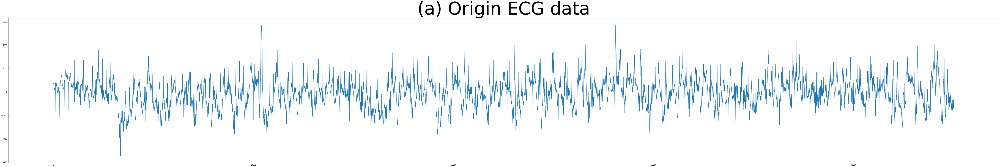

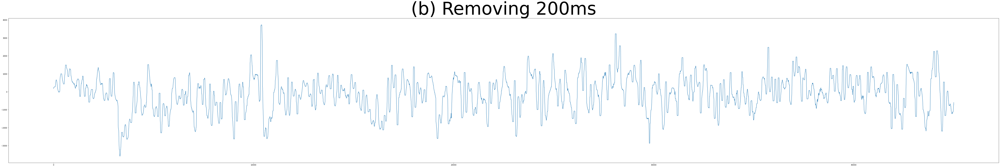

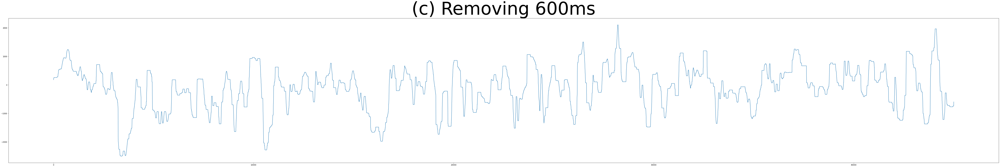

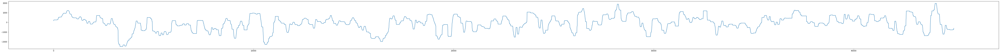

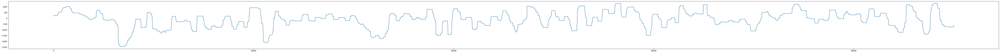

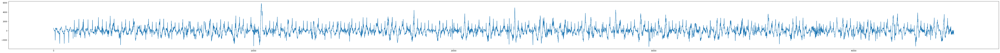

In [16]:
#---------訊號前處理
i = 5 

plt.figure(figsize=(100, 15))
plt.title('(a) Origin ECG data'  , fontsize = 100)
plt.plot(ecg_data[i].data_2[0*30*500:3*30*500])

s1 = scipy.signal.medfilt(ecg_data[i].data_2[0*30*500:3*30*500], 101)
plt.figure(figsize=(100, 15))
plt.title('(b) Removing 200ms' , fontsize = 100)
plt.plot(s1)

s2 = scipy.signal.medfilt(s1, 301)
plt.figure(figsize=(100, 15))
plt.title('(c) Removing 600ms'  , fontsize = 100)
plt.plot(s2)

s3 = scipy.signal.medfilt(s2, 101)
plt.figure(figsize=(100, 5))
plt.plot(s3)

s4 = scipy.signal.medfilt(s3, 301)
plt.figure(figsize=(100, 5))
plt.plot(s4)

plt.figure(figsize=(100, 5))
plt.plot(ecg_data[i].data_2[0*30*500:3*30*500] - s4)

plt.show()

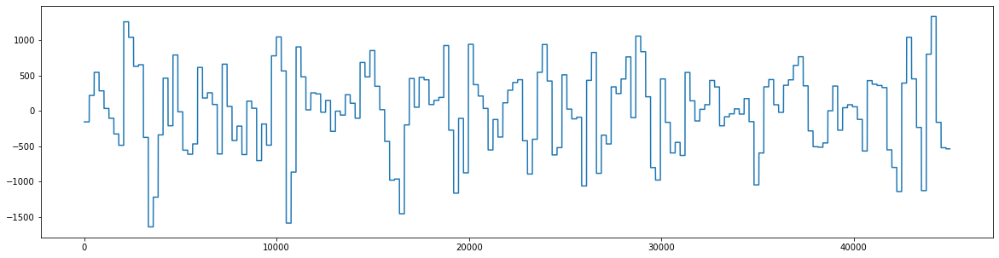

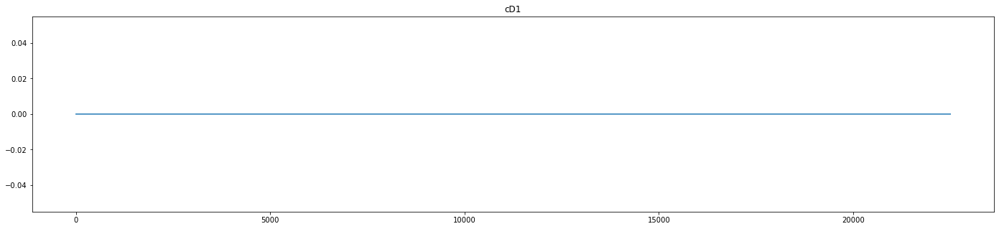

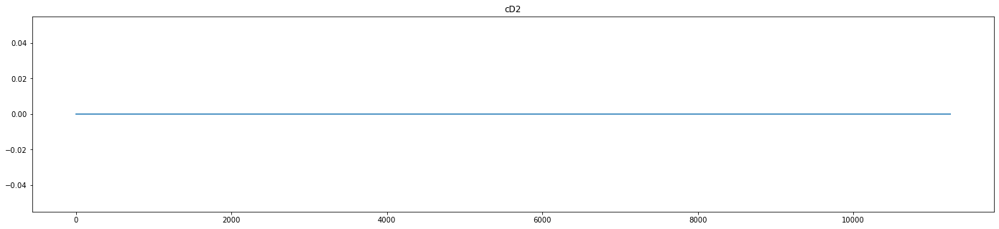

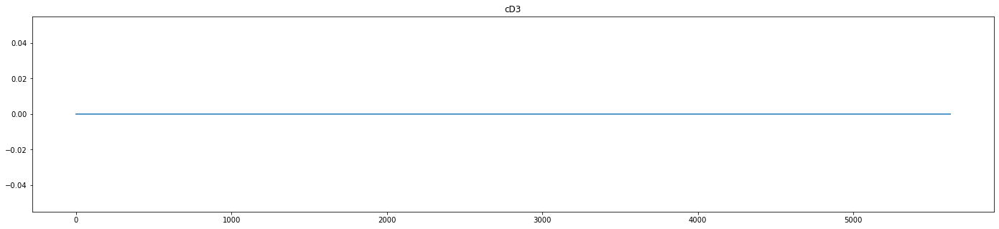

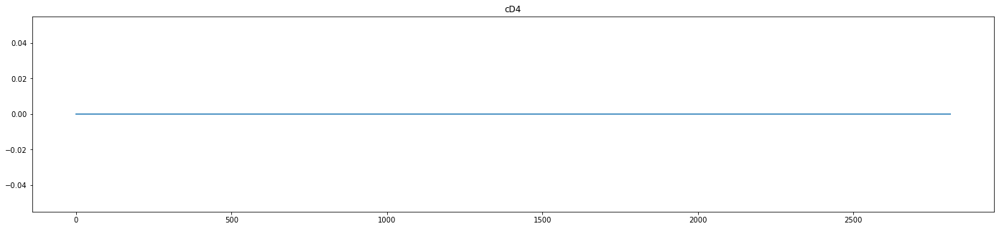

...

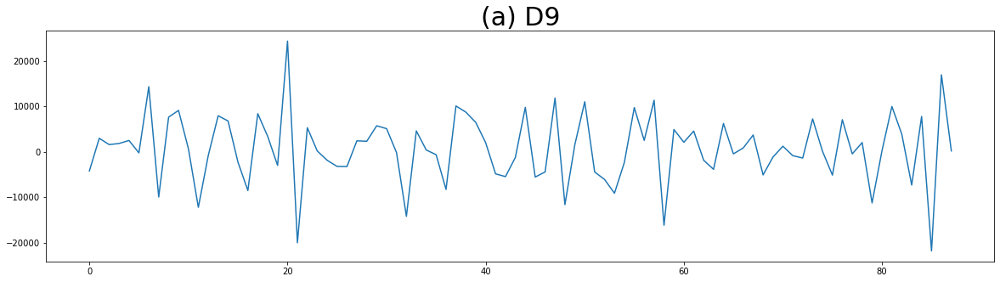

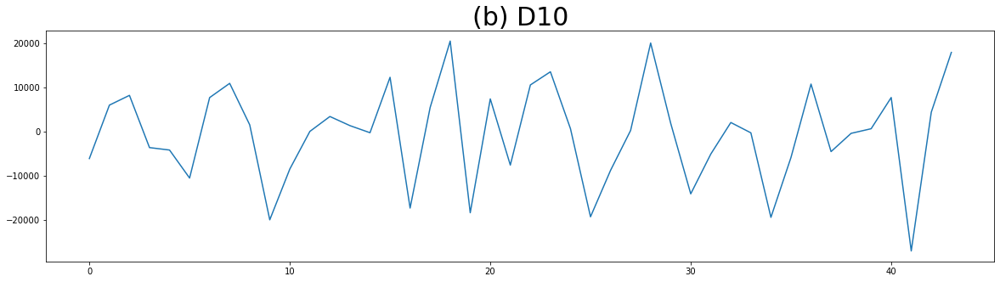

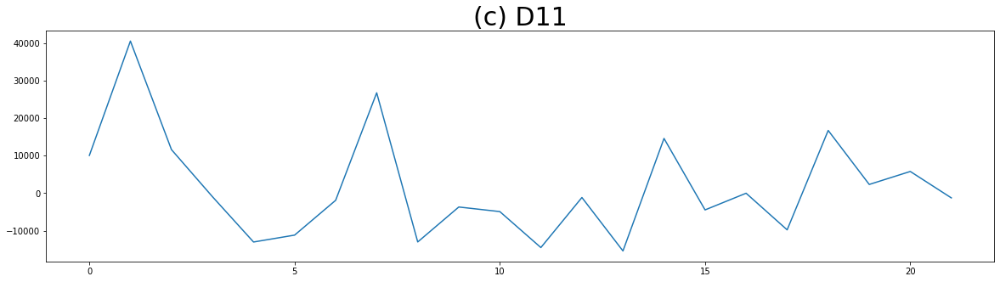

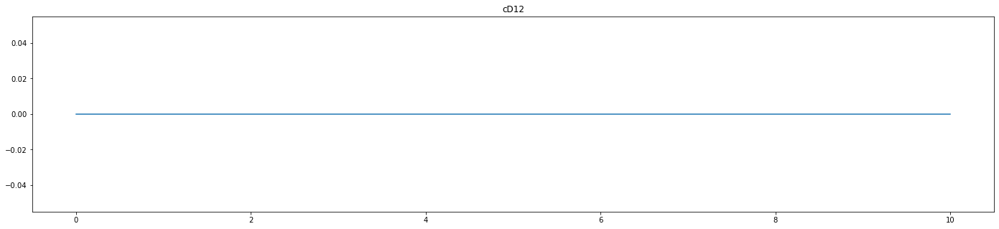

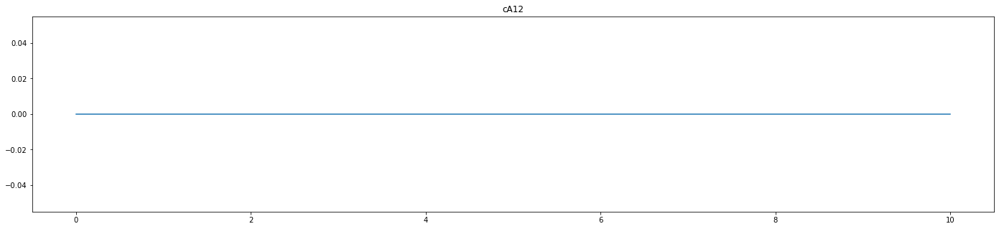

In [17]:
ecg_motion_ma = s4

#coeffs_rest = pywt.wavedec(data=ecg_rest, wavelet='haar', level=12)
#cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_rest

coeffs_motion = pywt.wavedec(data=ecg_motion_ma, wavelet='haar', level=12)
cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_motion
#####################################################################################

#threshold = (np.median(np.abs(cD1)) / 0.6745) * (np.sqrt(2 * np.log(len(cD1))))
# 將高頻訊號cD1、cD2置零

cD1.fill(0)
cD2.fill(0)
cD3.fill(0)
cD4.fill(0)
cD5.fill(0)
cD6.fill(0)
cD7.fill(0)
cD8.fill(0)

cD12.fill(0)
cA12.fill(0)


cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_motion
#coeffs_ma = np.array(coeffs_motion) - np.array(coeffs_rest)
#cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_ma

#for i in range(1, len(coeffs_motion) - 2):
#	coeffs_motion[i] = pywt.threshold(coeffs_motion[i], threshold)

rdata = pywt.waverec(coeffs=list(coeffs_motion), wavelet='haar')

#plt.figure(figsize=(24, 5))
#plt.plot(data)
#plt.show()
'''
plt.figure(figsize=(24, 5))
plt.title('coeffs_motion')
plt.plot(ecg_motion_ma)
plt.show()
'''
plt.figure(figsize=(20, 5))
#plt.title('(d) D9~D11 motion artifact' , fontsize = 30)
plt.plot(rdata)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD1')
plt.plot(cD1)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD2')
plt.plot(cD2)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD3')
plt.plot(cD3)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD4')
plt.plot(cD4)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD5')
plt.plot(cD5)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD6')
plt.plot(cD6)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD7')
plt.plot(cD7)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD8')
plt.plot(cD8)
plt.show()
plt.figure(figsize=(20, 5))
plt.title('(a) D9' , fontsize = 30)
plt.plot(cD9)
plt.show()
plt.figure(figsize=(20, 5))
plt.title('(b) D10' , fontsize = 30)
plt.plot(cD10)
plt.show()
plt.figure(figsize=(20, 5))
plt.title('(c) D11' , fontsize = 30)
plt.plot(cD11)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD12')
plt.plot(cD12)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cA12')
plt.plot(cA12)

plt.show()

In [18]:
x = rdata
y = s4
z = x - y

abs_percent = z.sum()/45000
print('abs_percent = ',abs_percent)
rel_percent = (abs_percent / y.sum())* 100
print('rel_percent = ',rel_percent,'%')

abs_percent =  103.03633602430556
rel_percent =  -0.0022367601952004235 %


In [7]:
with open('rdata16.csv', 'w', newline='') as rdata16_file:
    writer_rdata = csv.writer(rdata16_file)
    writer_rdata.writerow(["ecg"])
    data = list(map(lambda x:[x],rdata))
    for i in data:
        writer_rdata.writerow(i)

In [8]:
# RNN
dataset_train = pd.read_csv('rdata16.csv')  # 讀取訓練集
training_set = dataset_train.iloc[:, 0:1].values

sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

X_train = []   #預測點的前 60 天的資料
y_train = []   #預測點
for i in range(2000, 45000):  # (,訓練集總數) 是訓練集總數
    X_train.append(training_set_scaled[i-2000:i, 0])
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)  # 轉成numpy array的格式，以利輸入 RNN

X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))


# Initialising the RNN
regressor = Sequential()

# Adding the first LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 50, return_sequences = True, input_shape = (X_train.shape[1], 1)))
regressor.add(Dropout(0.2))

# Adding a second LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 50, return_sequences = True))
regressor.add(Dropout(0.2))

# Adding a third LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 50, return_sequences = True))
regressor.add(Dropout(0.2))

# Adding a fourth LSTM layer and some Dropout regularisation
regressor.add(LSTM(units = 50))
regressor.add(Dropout(0.2))

# Adding the output layer
regressor.add(Dense(units = 1))

# Compiling
regressor.compile(optimizer = 'adam', loss = 'mean_squared_error')

# 進行訓練
regressor.fit(X_train, y_train, epochs = 10, batch_size = 32)


Epoch 1/10
1344/1344 [==============================] - 4378s 3s/step - loss: 0.0051
Epoch 2/10
1344/1344 [==============================] - 4549s 3s/step - loss: 0.0020
Epoch 3/10
1344/1344 [==============================] - 4790s 4s/step - loss: 0.0013
Epoch 4/10
1344/1344 [==============================] - 4770s 4s/step - loss: 9.3985e-04
Epoch 5/10
1344/1344 [==============================] - 4929s 4s/step - loss: 7.8466e-04
Epoch 6/10
1344/1344 [==============================] - 4828s 4s/step - loss: 6.9690e-04
Epoch 7/10
1344/1344 [==============================] - 4760s 4s/step - loss: 6.8404e-04
Epoch 8/10
1344/1344 [==============================] - 4776s 4s/step - loss: 6.7736e-04
Epoch 9/10
1344/1344 [==============================] - 4650s 3s/step - loss: 6.5825e-04
Epoch 10/10
1344/1344 [==============================] - 4681s 3s/step - loss: 6.4928e-04


In [15]:
regressor.save('rnn_model.h5')

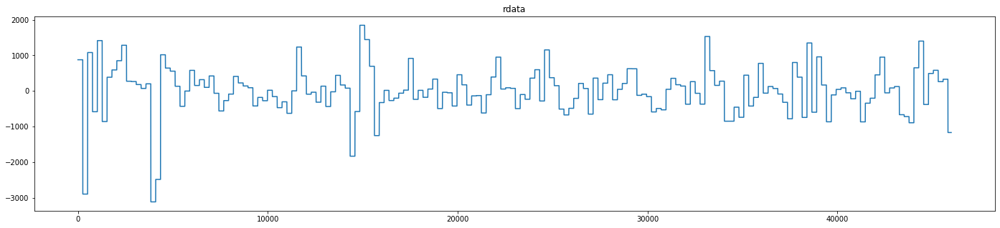

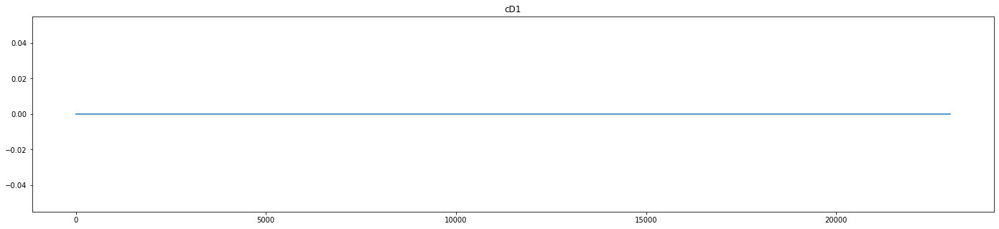

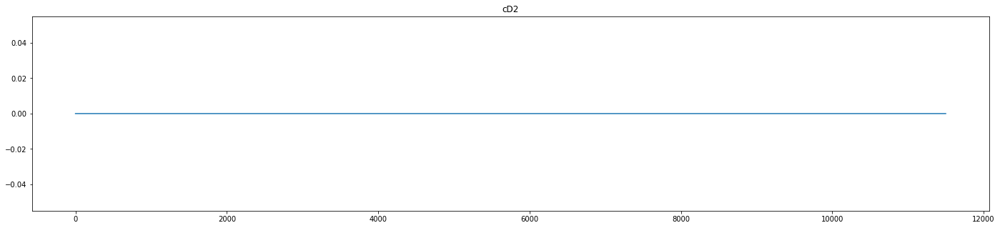

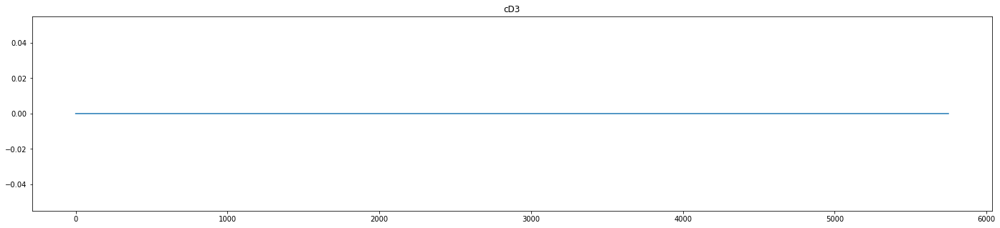

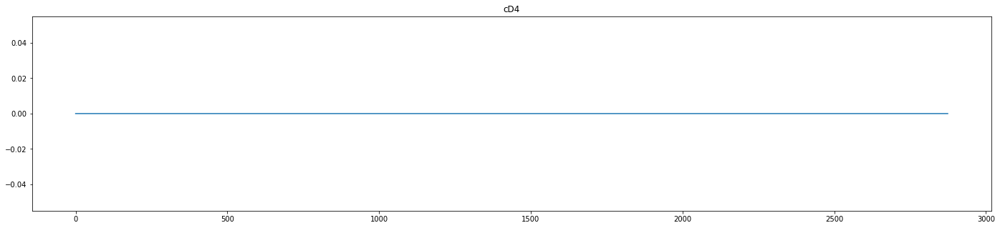

...

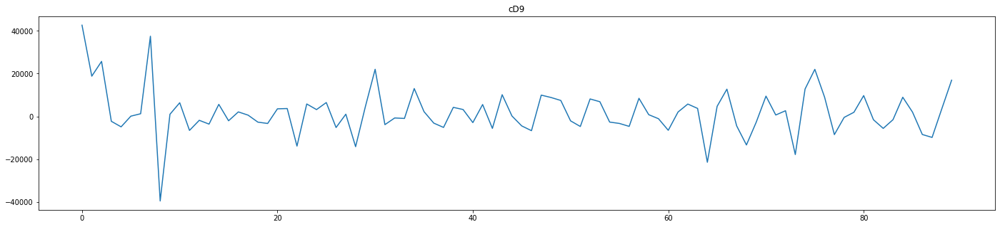

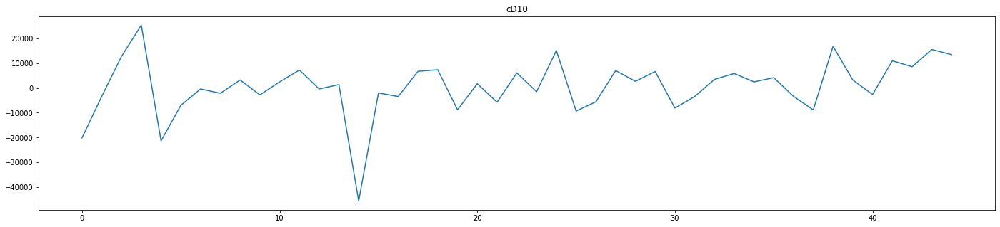

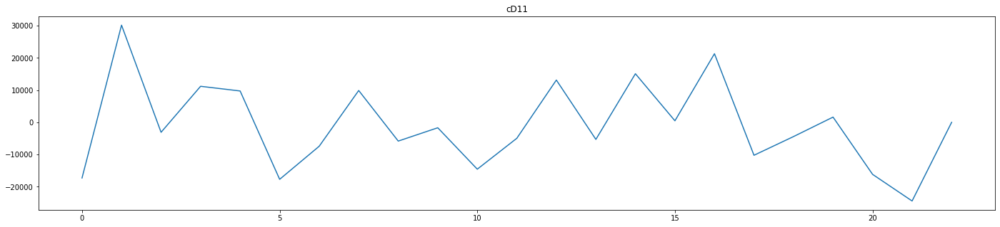

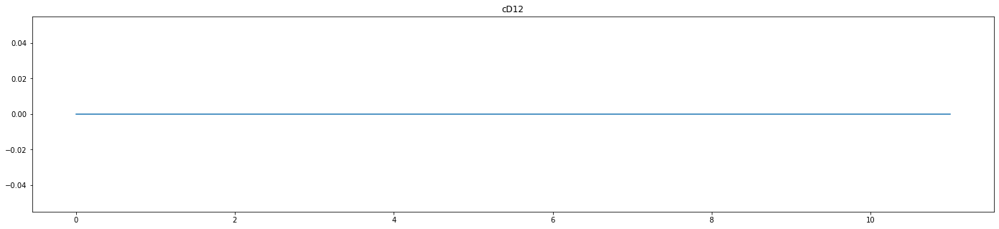

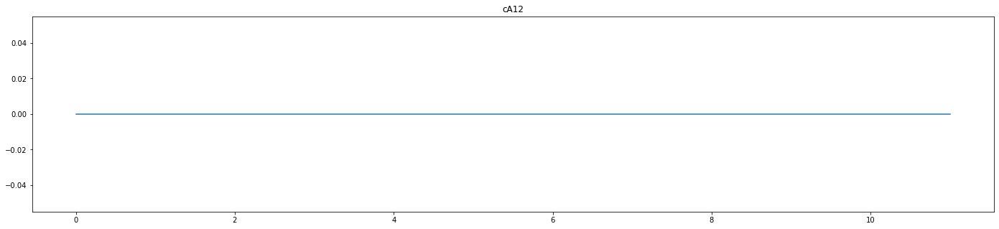

46000


In [8]:
i = 18
ecg_motion = ecg_data[i].data_2[0*30*500:46000]

#coeffs_rest = pywt.wavedec(data=ecg_rest, wavelet='haar', level=12)
#cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_rest

coeffs_motion = pywt.wavedec(data=ecg_motion, wavelet='haar', level=12)
cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_motion
#####################################################################################

#threshold = (np.median(np.abs(cD1)) / 0.6745) * (np.sqrt(2 * np.log(len(cD1))))
# 將高頻訊號cD1、cD2置零

cD1.fill(0)
cD2.fill(0)
cD3.fill(0)
cD4.fill(0)
cD5.fill(0)
cD6.fill(0)
cD7.fill(0)
cD8.fill(0)
cD12.fill(0)
cA12.fill(0)
cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_motion
#coeffs_ma = np.array(coeffs_motion) - np.array(coeffs_rest)
#cA12 ,cD12 , cD11, cD10, cD9, cD8, cD7, cD6, cD5, cD4, cD3, cD2, cD1 = coeffs_ma


# 將其他中低頻訊號按軟閾值公式濾波
#for i in range(1, len(coeffs_motion) - 2):
#	coeffs_motion[i] = pywt.threshold(coeffs_motion[i], threshold)

rdata = pywt.waverec(coeffs=list(coeffs_motion), wavelet='haar')

#plt.figure(figsize=(24, 5))
#plt.plot(data)
#plt.show()
'''
plt.figure(figsize=(24, 5))
plt.title('coeffs_motion')
plt.plot(coeffs_motion)
plt.show()
'''
plt.figure(figsize=(24, 5))
plt.title('rdata')
plt.plot(rdata)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD1')
plt.plot(cD1)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD2')
plt.plot(cD2)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD3')
plt.plot(cD3)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD4')
plt.plot(cD4)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD5')
plt.plot(cD5)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD6')
plt.plot(cD6)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD7')
plt.plot(cD7)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD8')
plt.plot(cD8)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD9')
plt.plot(cD9)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD10')
plt.plot(cD10)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD11')
plt.plot(cD11)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cD12')
plt.plot(cD12)
plt.show()
plt.figure(figsize=(24, 5))
plt.title('cA12')
plt.plot(cA12)
plt.show()
print(len(rdata))

In [9]:
with open('wavedec16_test.csv', 'w', newline='') as wavedec16_file_test:
    writer_test = csv.writer(wavedec16_file_test)
    writer_test.writerow(["ecg"])
    data = list(map(lambda x:[x],rdata))
    for i in data:
        writer_test.writerow(i)


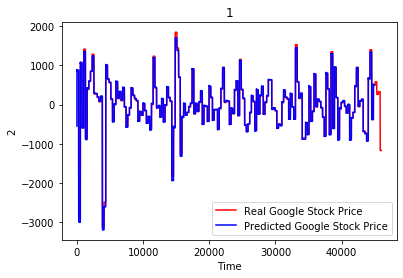

In [10]:
model = tf.keras.models.load_model('rnn_model.h5')
############# Import the training set
dataset_train = pd.read_csv('rdata16.csv')  # 讀取訓練集
training_set = dataset_train.iloc[:, 0:1].values

sc = MinMaxScaler(feature_range = (0, 1))
training_set_scaled = sc.fit_transform(training_set)

X_train = []   #預測點的前 60 天的資料
y_train = []   #預測點
for i in range(1000, 45000):  # (,訓練集總數) 是訓練集總數
    X_train.append(training_set_scaled[i-1000:i, 0])
    y_train.append(training_set_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)  # 轉成numpy array的格式，以利輸入 RNN

X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
############################################################################## test
dataset_test = pd.read_csv('wavedec16_test.csv')
real_stock_price = dataset_test.iloc[:, 0:1].values

dataset_total = pd.concat((dataset_train['ecg'], dataset_test['ecg']), axis = 0)
inputs = dataset_total[len(dataset_total) - len(dataset_test) - 1000:].values
inputs = inputs.reshape(-1,1)
inputs = sc.transform(inputs) # Feature Scaling

X_test = []
for i in range(1000, 46000):  # timestep:800； 1406
    X_test.append(inputs[i-1000:i, 0])
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))  # Reshape 成 3-dimension

predicted_stock_price = model.predict(X_test)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)  # to get the original scale

# Visualising the results
plt.plot(real_stock_price, color = 'red', label = 'Real Google Stock Price')  # 紅線表示真實股價
plt.plot(predicted_stock_price, color = 'blue', label = 'Predicted Google Stock Price')  # 藍線表示預測股價
plt.title('1')
plt.xlabel('Time')
plt.ylabel('2')
plt.legend()
plt.show()

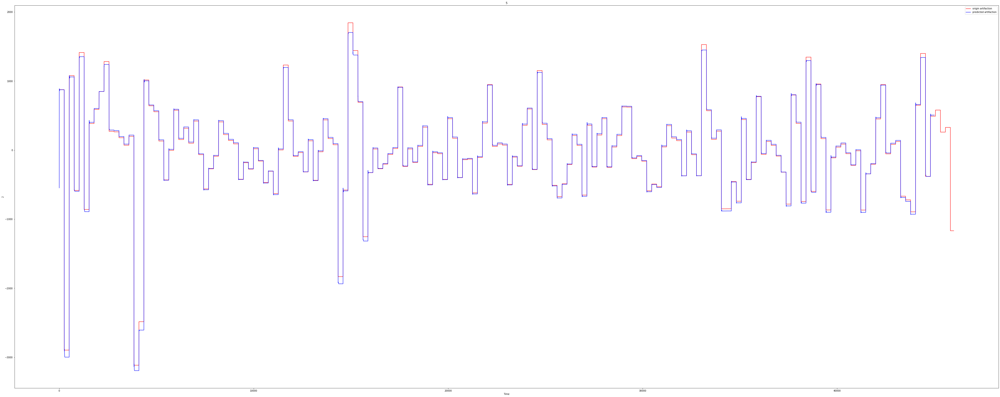

In [11]:
plt.figure(figsize=(75, 30))
plt.plot(real_stock_price, color = 'red', label = 'origin artifaction')  # 紅線表示真實股價
plt.plot(predicted_stock_price, color = 'blue', label = 'predicted artifaction')  # 藍線表示預測股價
plt.title('5')
plt.xlabel('Time')
plt.ylabel('2')
plt.legend()

In [12]:
real_stock_price = dataset_test.iloc[:45000, 0:1].values
print(predicted_stock_price.dtype)
predicted_stock_price_2 = predicted_stock_price.reshape(45000) #二維轉一維陣列
print(predicted_stock_price_2)
#for i in range(0,predicted_stock_price.length):
#    list.add(predicted_stock_price[i]);


float32
[-548.44604  631.8857   809.4618  ...  506.7055   506.7057   506.7057 ]


45000


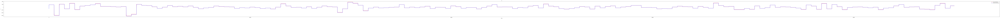

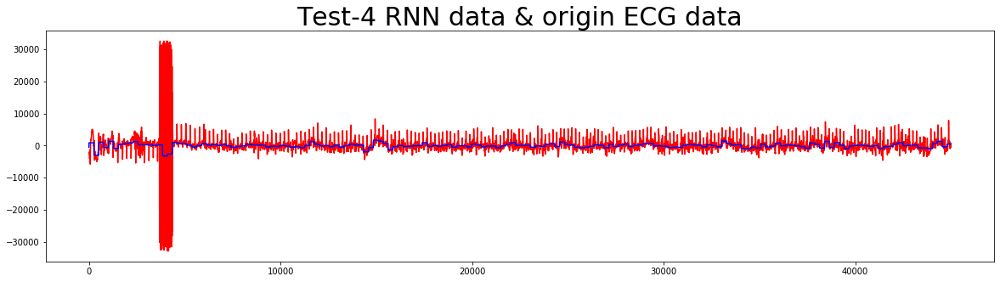

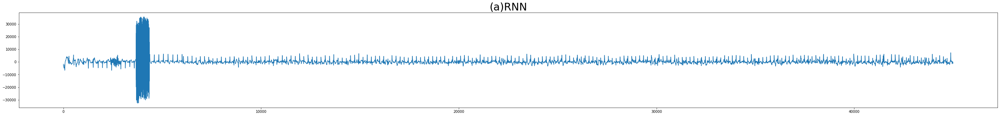

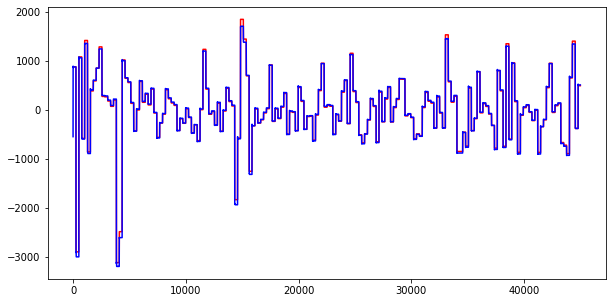

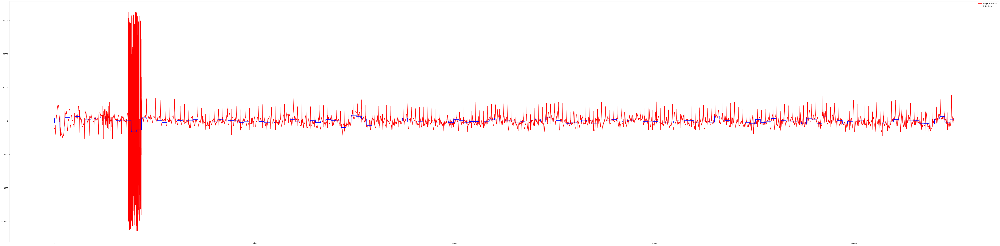

In [13]:
i = 18
plt.figure(figsize=(300, 5))
plt.plot(real_stock_price, color = 'red', label = 'origin artifaction')  # 紅線表示真實股價
plt.plot(predicted_stock_price_2, color = 'blue', label = 'predicted artifaction')  # 藍線表示預測股價
plt.title('5')
plt.xlabel('Time')
plt.ylabel('2')
plt.legend()

rnn_data = ecg_data[i].data_2[0*30*500:3*30*500] - predicted_stock_price_2
print(len(rnn_data))
plt.figure(figsize=(20, 5))
plt.plot(ecg_data[i].data_2[0*30*500:3*30*500], color = 'red', label = 'origin ECG data' )  # 紅線表示真實股價
plt.plot(predicted_stock_price, color = 'blue', label = 'RNN data')  # 藍線表示預測股價
plt.title('Test-4 RNN data & origin ECG data' , fontsize = 30)

plt.figure(figsize=(50, 5))
plt.title('(a)RNN',fontsize='30')
plt.plot(rnn_data)

plt.figure(figsize=(10, 5))
plt.plot(real_stock_price, color = 'red', label = 'origin ECG data')  # 紅線表示真實股價
plt.plot(predicted_stock_price, color = 'blue', label = 'RNN data')  # 藍線表示預測股價

plt.figure(figsize=(100, 25))
plt.plot(ecg_data[i].data_2[0*30*500:3*30*500], color = 'red', label = 'origin ECG data')  # 紅線表示真實股價
plt.plot(predicted_stock_price, color = 'blue', label = 'RNN data')  # 藍線表示預測股價
plt.legend()


In [16]:
correlation_ecg = correlation(predicted_stock_price ,ecg_data[i].data_2[0*30*500:3*30*500])
print(correlation_ecg)

[0.23760827]


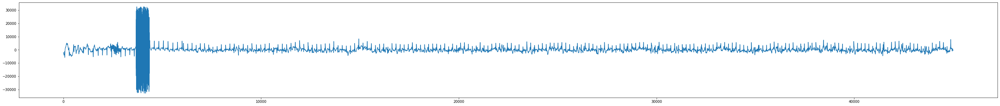

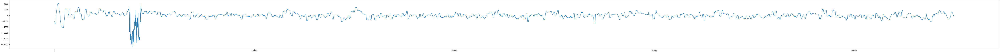

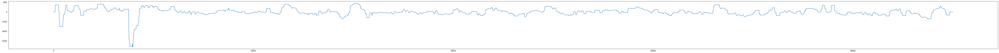

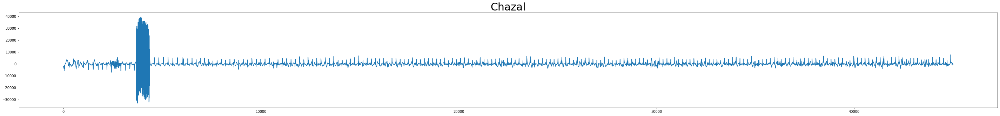

In [19]:
i = 18

plt.figure(figsize=(50, 5))
plt.plot(ecg_data[i].data_2[0*30*500:3*30*500])

s1 = scipy.signal.medfilt(ecg_data[i].data_2[0*30*500:3*30*500], 101)
plt.figure(figsize=(100, 5))
plt.plot(s1)

med_filiter_MotionArtifact = scipy.signal.medfilt(s1, 301)
plt.figure(figsize=(100, 5))
plt.plot(med_filiter_MotionArtifact)

med_filiter = ecg_data[i].data_2[0*30*500:3*30*500] - med_filiter_MotionArtifact
plt.figure(figsize=(50, 5))
plt.title('Chazal',fontsize='30')
plt.plot(med_filiter)

plt.show()

<function matplotlib.pyplot.show(*args, **kw)>

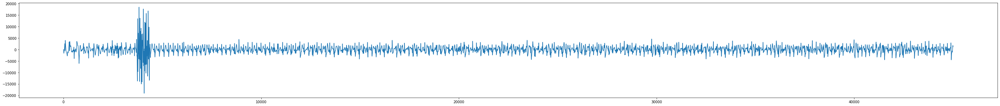

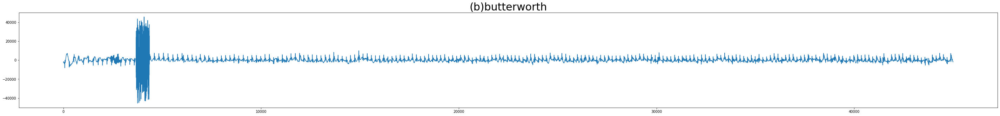

In [20]:
##butter_worth
i = 18
#b, a = signal.butter(4, [1/500, 16/500], btype='bandpass')
b, a = butter_bandpass(1.67, 20, 500)
'''
butter_worth = signal.lfilter(b, a, ecg_data[i].data_2[0*30*500:3*30*500]) #休息中(對照)
plt.figure(figsize=(300, 5))
plt.plot(butter_worth)
'''
butter_worth = signal.lfilter(b, a, ecg_data[i].data_2[0*30*500:3*30*500]) #運動中
plt.figure(figsize=(50, 5))
plt.plot(butter_worth)

butter_worth_MotionArtifact = ecg_data[i].data_2[0*30*500:3*30*500] - butter_worth
plt.figure(figsize=(50, 5))
plt.title('(b)butterworth',fontsize='30')
plt.plot(butter_worth_MotionArtifact)
plt.show


<function matplotlib.pyplot.show(*args, **kw)>

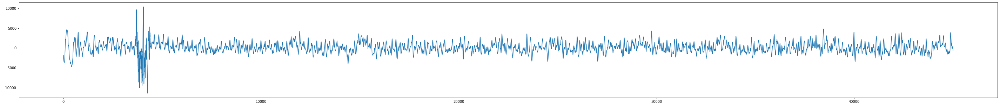

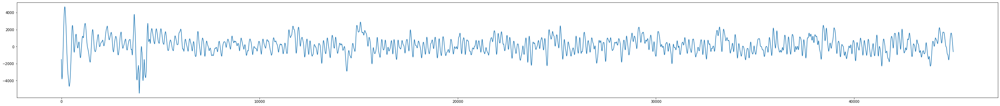

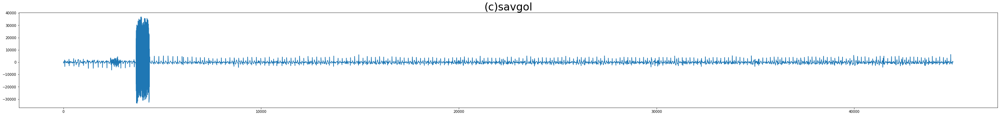

In [21]:
#savgol_filter

savgol_filtered_MotionArtifact = scipy.signal.savgol_filter(ecg_data[i].data_2[0*30*500:3*30*500], 101, 4) # window size 37, polynomial order 3
plt.figure(figsize=(50, 5))
plt.plot(savgol_filtered_MotionArtifact)

savgol_filtered_MotionArtifact = scipy.signal.savgol_filter(savgol_filtered_MotionArtifact, 301, 4)
plt.figure(figsize=(50, 5))
plt.plot(savgol_filtered_MotionArtifact)

savgol_filtered = ecg_data[i].data_2[0*30*500:3*30*500] - savgol_filtered_MotionArtifact
plt.figure(figsize=(50, 5))
plt.title('(c)savgol',fontsize='30')
plt.plot(savgol_filtered)
plt.show

In [22]:
#butter_worth_MotionArtifact = butter_worth_MotionArtifact.astype(np.int8)
#savgol_filtered_MotionArtifact = savgol_filtered_MotionArtifact.astype(np.int8)
#butter_worth = butter_worth.astype(np.int8)
#savgol_filtered = savgol_filtered.astype(np.int8)
origin_ecg = np.array(ecg_data[i].data_2[0*30*500:3*30*500])
print(butter_worth.dtype)
print(savgol_filtered.dtype)
print(med_filiter.dtype)
print(predicted_stock_price_2.dtype)
print(origin_ecg.dtype)

float64
float64
float64
float32
int32


abs_percent =  1.8377555555555556
rel_percent =  2.6433743890778667e-05 %


<function matplotlib.pyplot.show(*args, **kw)>

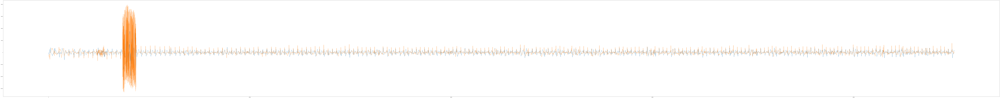

In [322]:
x = med_filiter
y = origin_ecg
z = x - y

abs_percent = z.sum()/45000
print('abs_percent = ',abs_percent)
rel_percent = (abs_percent / y.sum())* 100
print('rel_percent = ',abs(rel_percent),'%')
plt.figure(figsize=(300, 30))
plt.plot(butter_worth)
plt.plot(med_filiter)
plt.show

abs_percent =  -155.19874226237772
rel_percent =  0.0022323337795022878 %


<function matplotlib.pyplot.show(*args, **kw)>

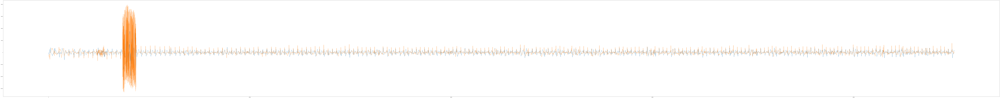

In [323]:
x = butter_worth
y = origin_ecg
z = x - y

abs_percent = z.sum()/45000
print('abs_percent = ',abs_percent)
rel_percent = (abs_percent / y.sum())* 100
print('rel_percent = ',abs(rel_percent),'%')
plt.figure(figsize=(300, 30))
plt.plot(butter_worth)
plt.plot(med_filiter)
plt.show

abs_percent =  4.624326245523492
rel_percent =  6.651496999807535e-05 %


<function matplotlib.pyplot.show(*args, **kw)>

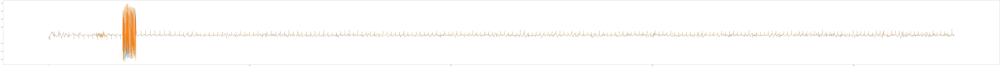

In [324]:
x = rnn_data
y = origin_ecg
z = x - y

abs_percent = z.sum()/45000
print('abs_percent = ',abs_percent)
rel_percent = (abs_percent / y.sum())* 100
print('rel_percent = ',abs(rel_percent),'%')
plt.figure(figsize=(300, 20))
plt.plot(rnn_data)
plt.plot(med_filiter)
plt.show

abs_percent =  -154.27541384796677
rel_percent =  0.0022190528908880023 %


<function matplotlib.pyplot.show(*args, **kw)>

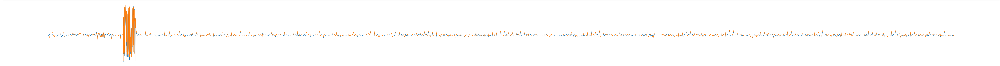

In [325]:
x = savgol_filtered
y = origin_ecg
z = x - y

abs_percent = z.sum()/45000
print('abs_percent = ',abs_percent)
rel_percent = (abs_percent / y.sum())* 100
print('rel_percent = ',abs(rel_percent),'%')
plt.figure(figsize=(300, 20))
plt.plot(savgol_filtered)
plt.plot(med_filiter)
plt.show

<function matplotlib.pyplot.show(*args, **kw)>

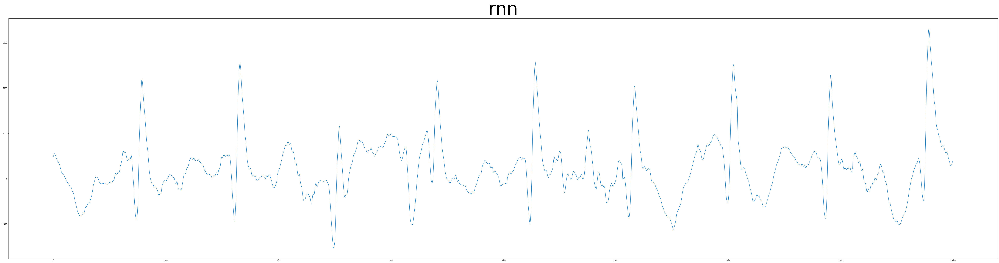

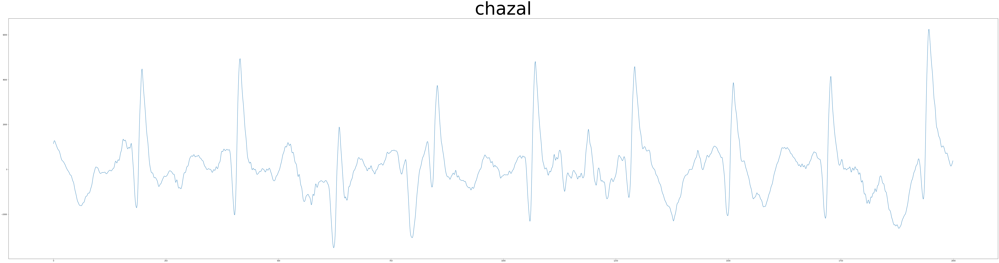

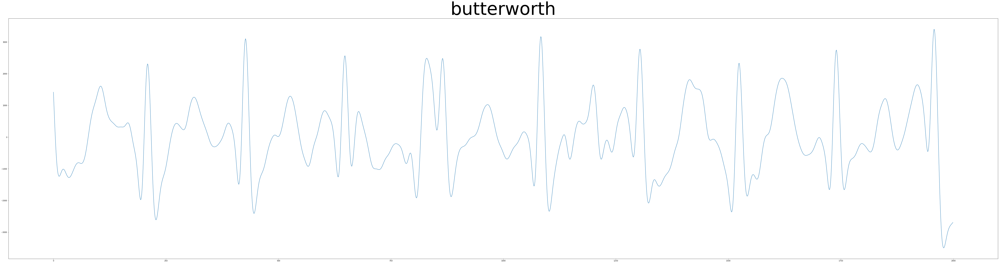

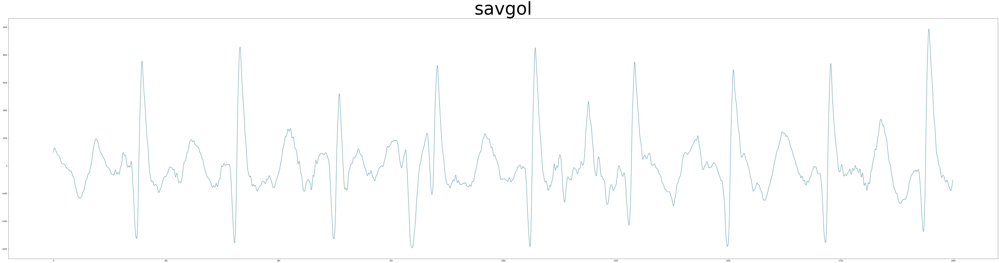

In [326]:
plt.figure(figsize=(100, 25))
plt.title('rnn',fontsize='100')
plt.plot(rnn_data[10000:12000])

plt.figure(figsize=(100, 25))
plt.title('chazal',fontsize='100')
plt.plot(med_filiter[10000:12000])

plt.figure(figsize=(100, 25))
plt.title('butterworth',fontsize='100')
plt.plot(butter_worth[10000:12000])

plt.figure(figsize=(100, 25))
plt.title('savgol',fontsize='100')
plt.plot(savgol_filtered[10000:12000])
plt.show

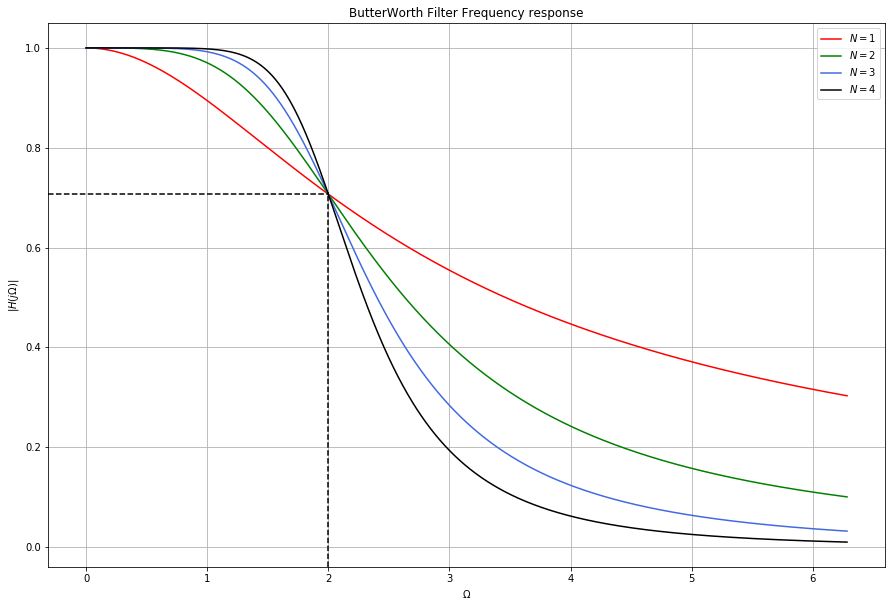

In [121]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.signal as signal

w = 2*np.pi*np.linspace(0, 1, 10000)

system1 = signal.butter(1, 2, btype='low', analog=True, output='ba')
w1, H1 = signal.freqresp(system1, w)

system2 = signal.butter(2, 2, btype='low', analog=True, output='ba')
w2, H2 = signal.freqresp(system2, w)

system3 = signal.butter(3, 2, btype='low', analog=True, output='ba')
w3, H3 = signal.freqresp(system3, w)

system4 = signal.butter(4, 2, btype='low', analog=True, output='ba')
w4, H4 = signal.freqresp(system4, w)

plt.figure(figsize=(15,10))
#plt.subplot(121) 
plt.title('ButterWorth Filter Frequency response')
plt.plot(w1, abs(H1), 'red', label='$N=1$')
plt.plot(w2, abs(H2), 'g', label='$N=2$')
plt.plot(w3, abs(H3), 'royalblue', label='$N=3$')
plt.plot(w4, abs(H4), 'black', label='$N=4$')
plt.axvline(2, ymin=0, ymax=0.69, color='black', ls='dashed')
plt.axhline(0.707, xmin=0, xmax=0.335, color='black', ls='dashed')
plt.grid(True)
plt.ylabel('$|H(j\Omega)|$')
plt.xlabel('$\Omega$')
plt.legend(fontsize=10, loc='upper right')
'''
plt.subplot(122)
plt.plot(w1, np.angle(H1), 'red')
plt.plot(w2, np.angle(H2), 'g')
plt.plot(w3, np.angle(H3), 'royalblue')
plt.plot(w4, np.angle(H4), 'black')
plt.grid(True)
plt.ylabel(r'$\angle H(j\Omega)$')
plt.xlabel('$\Omega$')
plt.tight_layout()  
plt.savefig('3_Butterworth filter.png', dpi=600) 
'''
plt.show()


In [84]:
def fft_freq(data):
    Fs = 500
    L = len (data)                        
    N = int(np.power(2,np.ceil(np.log2(L))))    
    FFT_y1 = np.abs(fft(data,N))/L*2      
    Fre = np.arange(int(N/2))*Fs/N        
    FFT_y1 = FFT_y1[range(int(N/2))]     
    return Fre, FFT_y1
##-----------------------------------------------------------
def NormaliseCorrelate(a,v): #-1~1 (statistics ) 
    corr_series = []
    M = len(a)
    N = len(v)
    a = np.array(a)
    v = np.array(v)
    v_mean = np.mean(v)
    for i in range(M-N+1):
        _a = a[i:i+N]
        sum_a = _a - np.mean(_a)
        sum_v = v - v_mean
        nr = 1/N * np.sum((sum_a*sum_v) ) / np.sqrt(np.var(_a)*np.var(v))
        corr_series.append(nr)
    return corr_series

D:\anaconda\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
D:\anaconda\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
D:\anaconda\lib\site-packages\numpy\core\_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


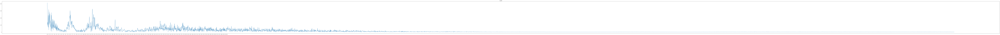

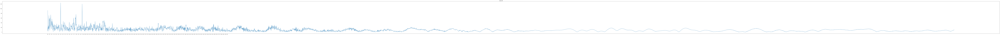

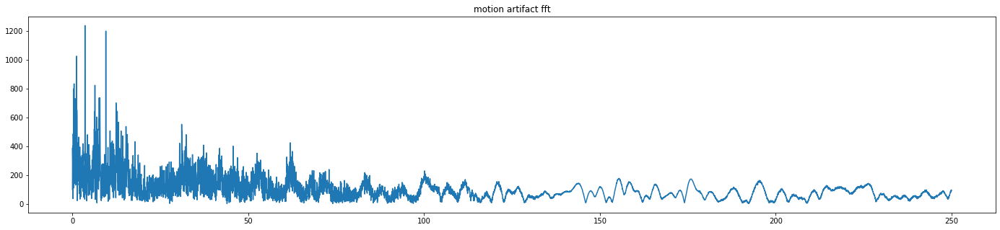

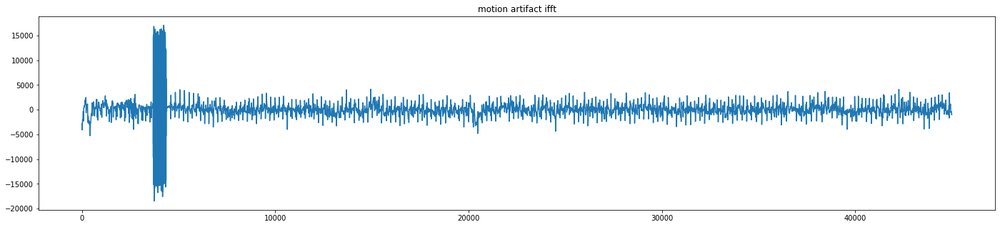

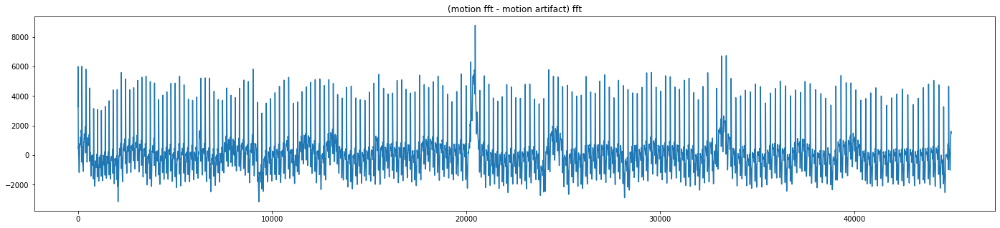

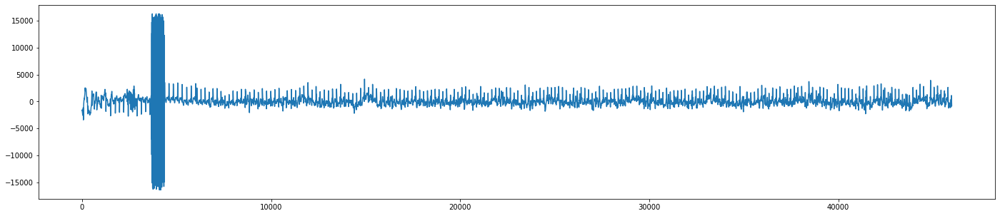

In [246]:
from matplotlib.ticker import MaxNLocator
i = 18
ecg_motion = ecg_data[i].data_2[0*30*500:3*30*500] # 90-150 運動中一分半～二分半
ecg_rest = ecg_data[i].data_2[7*30*500:10*30*500] # 270-330 休息中一分半～二分半

ecg_rest_fft = fft(ecg_rest)
ecg_rest_ifft = ifft(ecg_rest)

N = 15000
T = 1.0 / 500

xf_rest = fftfreq(N, T)[:N//2]
yf_rest = abs(ecg_rest_fft)
'''
ecg_image_motion = ecg_rest_fft

for x in range(0, int(np.where(xf_rest == 0.2)[0])):
    ecg_image_motion[x] = 0
for x in range(int(np.where(xf_rest == 1.6)[0]), len(ecg_image_motion)):
    ecg_image_motion[x] = 0

yf_rest = ecg_rest_fft

yf_rest_ifft = ifft(yf_rest)
'''
plt.figure(figsize=(300, 10)) # 休息中 傅立葉
plt.title("rest fft")
my_x_ticks = np.arange(0, 50, 0.5)
plt.xticks(my_x_ticks)
plt.plot(xf_rest, 2.0 / N * yf_rest[0:N//2])
##--------------------------------------------------------------------------------運動中訊號傅立葉轉換
ecg_motion_fft = fft(ecg_motion) # ecg motion

xf_motion = fftfreq(N, T)[:N//2]
yf_motion = abs(ecg_motion_fft)

plt.figure(figsize=(300, 10)) # 運動中 傅立葉
plt.title("motion fft")
my_x_ticks = np.arange(0, 50, 0.5)
plt.xticks(my_x_ticks)
plt.plot(xf_motion, 2.0 / N * yf_motion[0:N//2])
##--------------------------------------------------------------------------------取運動中訊號運動偽影(運動中傅立葉訊號-休息中傅立葉訊號)
ecg_ma_fft = ecg_motion_fft - ecg_rest_fft # ecg motion_artifact
ecg_ma_ifft = ifft(ecg_ma_fft)

xf_ma = fftfreq(N, T)[:N//2]
yf_ma = abs(ecg_ma_fft)

plt.figure(figsize=(24, 5)) # 運動偽影 傅立葉
plt.title("motion artifact fft")
plt.plot(xf_ma, 2.0 / N * yf_ma[0:N//2])

plt.figure(figsize=(24, 5)) # 運動偽影 反傅立葉
plt.title("motion artifact ifft")
plt.plot(ecg_ma_ifft // 2)
##--------------------------------------------------------------------------------運動中訊號 - 理論運動偽影
a = ecg_motion_fft - ecg_ma_fft 
#xf_a = fftfreq(N, T)[:N//2]
#yf_a = abs(a)
ecg_a_ifft = ifft(a)

plt.figure(figsize=(24, 5)) # 運動中 - 運動偽影 反傅立葉
plt.title("(motion fft - motion artifact) fft")
plt.plot(ecg_a_ifft)

##--------------------------------------------------------------------------------理論運動偽影取0.2-1.6
'''
ecg_image_motion = rdata

for x in range(0, int(np.where(xf_motion == 0)[0])):
    ecg_image_motion[x] = 0
for x in range(int(np.where(xf_motion == 5)[0]), len(ecg_image_motion)):
    ecg_image_motion[x] = 0

yf_ma_range_fft = ecg_ma_fft
yf_ma_range_ifft = ifft(yf_ma_range_fft)

plt.figure(figsize=(24, 5)) # 0.2-1.6 傅立葉(18)
plt.title("motion artifact fft")
plt.plot(range(0,18), 2.0 / N * yf_ma_range_fft[int(np.where(xf_rest == 0.2)[0]):int(np.where(xf_rest == 1.6)[0])//2])
plt.figure(figsize=(24, 5)) # 0.2-1.6 傅立葉(15000)
plt.title("motion artifact(all) fft")
plt.plot(xf_motion, 2.0 / N * yf_ma_range_fft[0:N//2])
'''
##--------------------------------------------------------------------------------運動中訊號 - 理論運動偽影 + (0.2-1.6)
'''
b = a + yf_ma_range_fft

ecg_b_ifft = ifft(b)

plt.figure(figsize=(24, 5)) # 運動中 - 運動偽影 + (0.2-1.6) 反傅立葉
plt.title("(motion fft - motion artifact + 0.2-1.6) fft")
plt.plot(ecg_b_ifft)
'''
##--------------------------------------------------------------------------------


plt.figure(figsize=(24, 5)) # 0.2-1.6 反傅立葉
plt.plot(yf_ma_range_ifft // 2 )
##--------------------------------------------------------------------------------


In [139]:
ecg_motion = ecg_data[i].data_2[8*30*500:10*30*500]
N = 90000
T = 1.0 / 500
ecg_motion_fft = fft(ecg_motion)
xf_motion = fftfreq(N, T)[:N//2]
ecg_image_motion = ecg_motion_fft

for x in range(0, int(np.where(xf_motion == 0.4)[0])):
    ecg_image_motion[x] = 0

yf_ma_range_fft = ecg_motion_fft
yf_ma_range_ifft = ifft(yf_ma_range_fft)

plt.figure(figsize=(24, 5))
plt.plot(xf_motion, 2.0 / N * yf_ma_range_fft[0:N//2])

NameError: name 'fft' is not defined

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

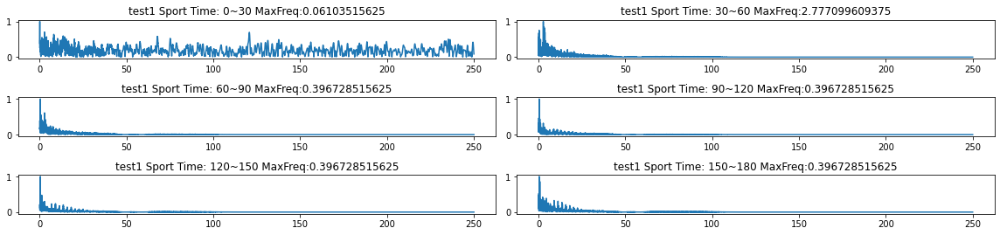

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

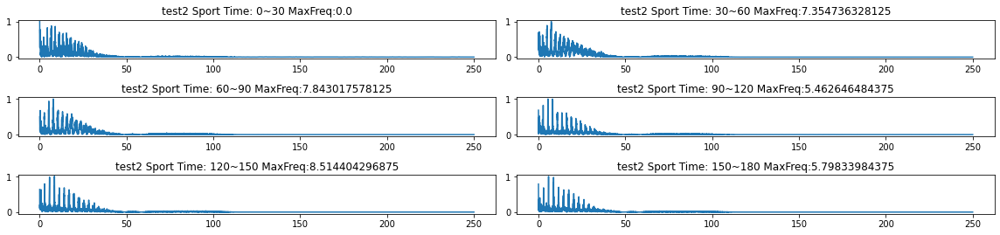

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

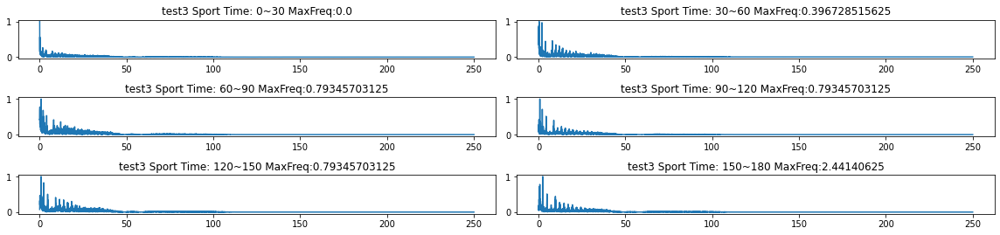

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

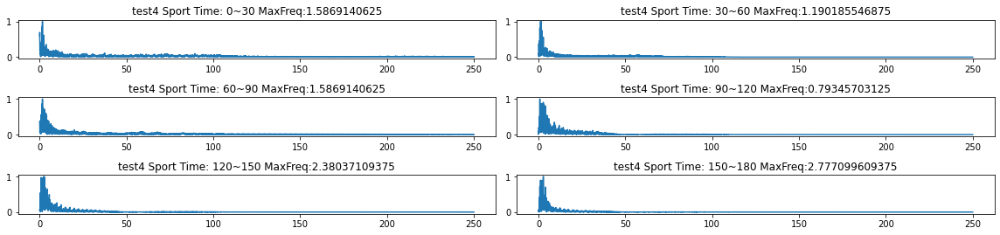

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

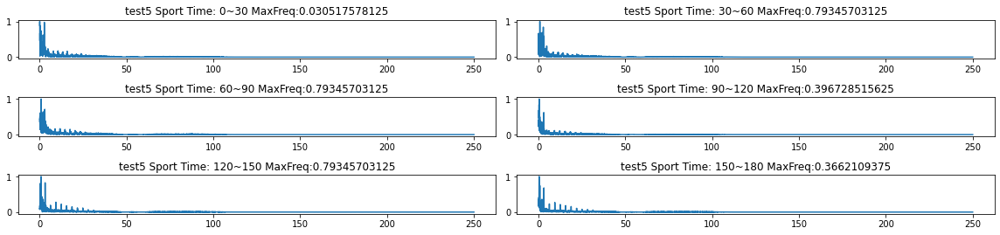

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

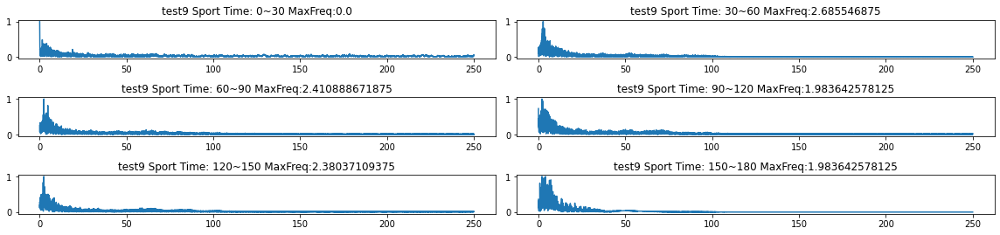

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

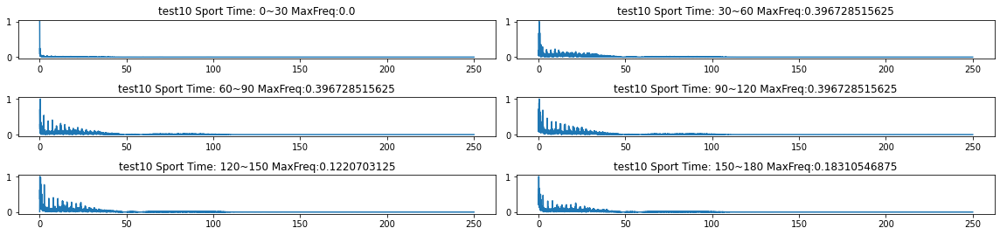

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

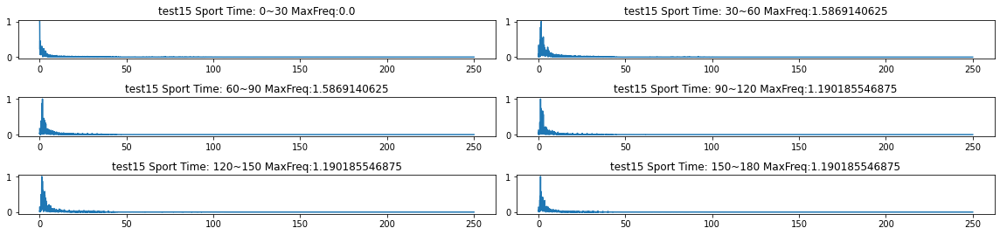

ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:11: MatplotlibDeprecationWarning: Passing non-integers as thr

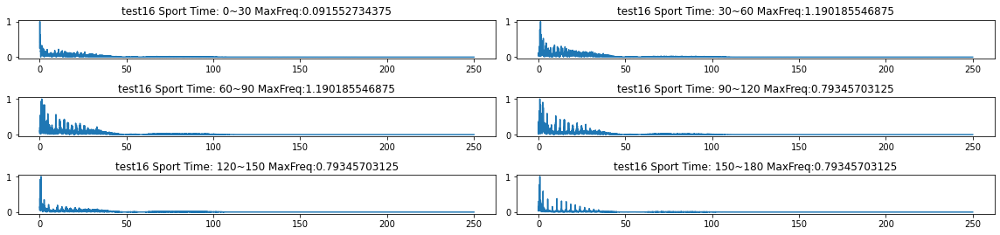

ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
ipykernel_launcher:25: MatplotlibDeprecationWarning: Passing non-integers as thr

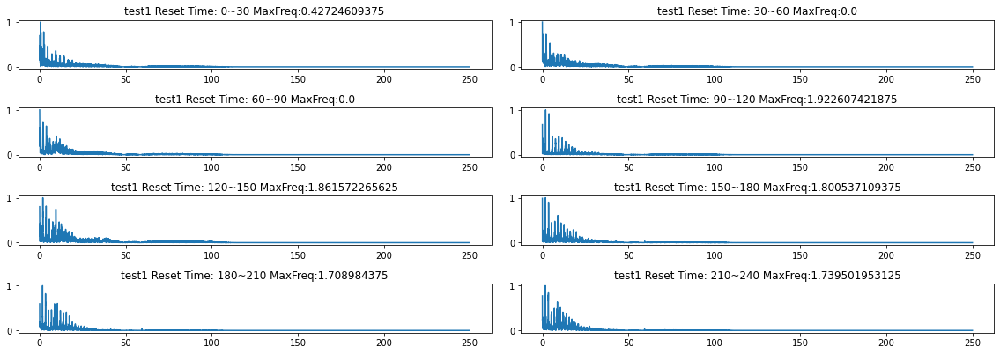

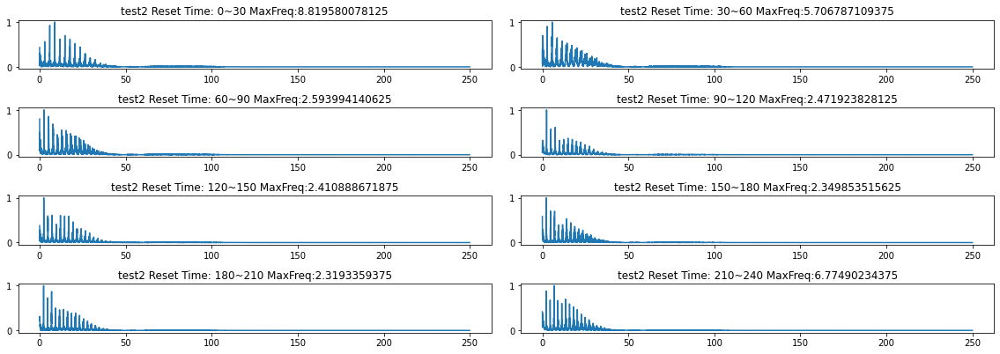

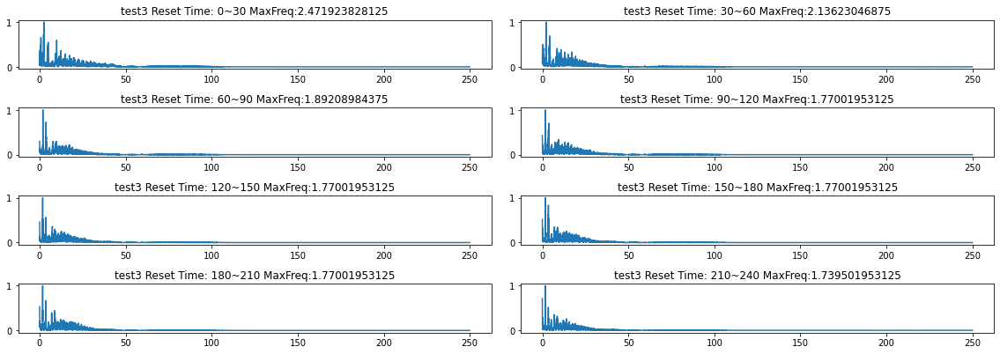

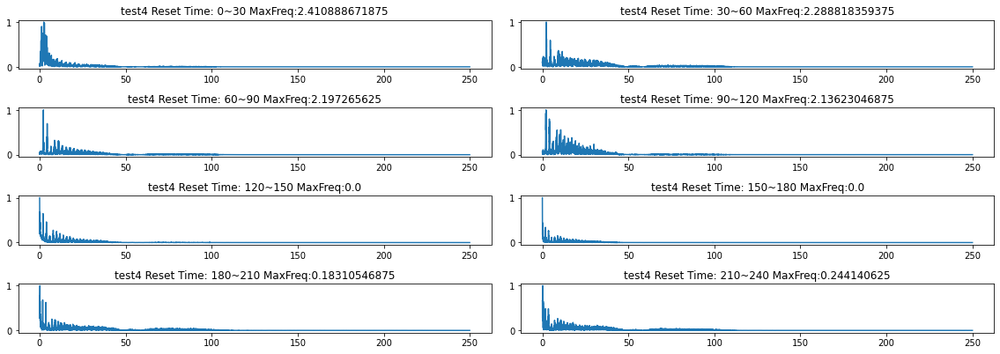

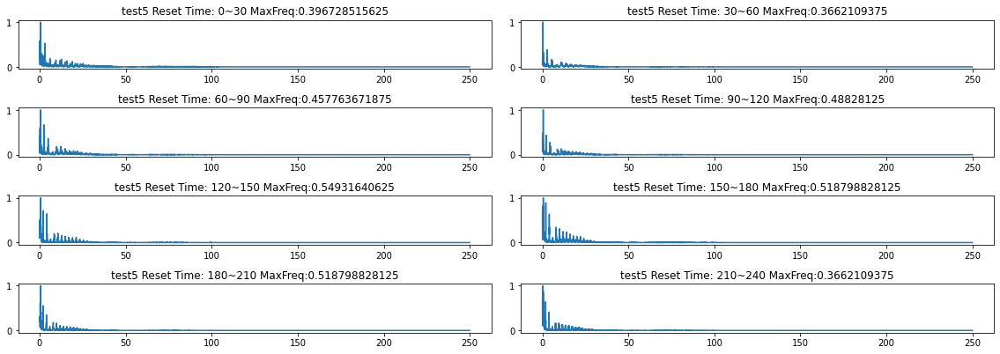

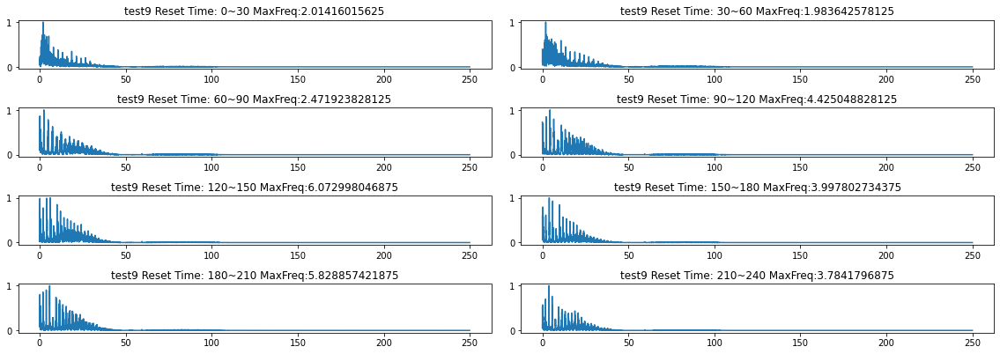

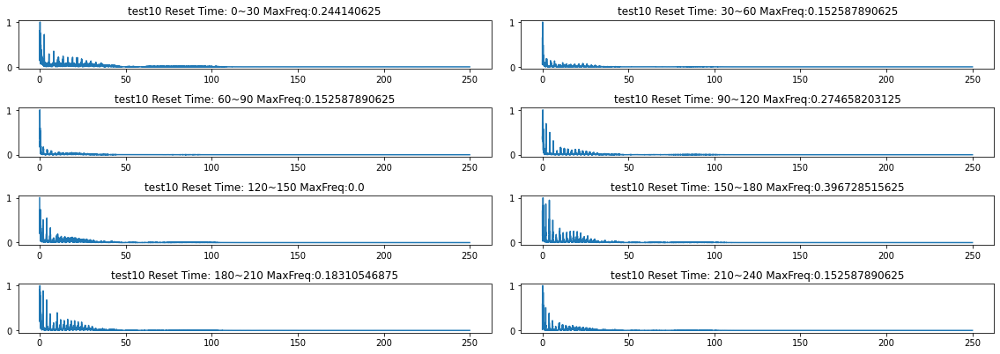

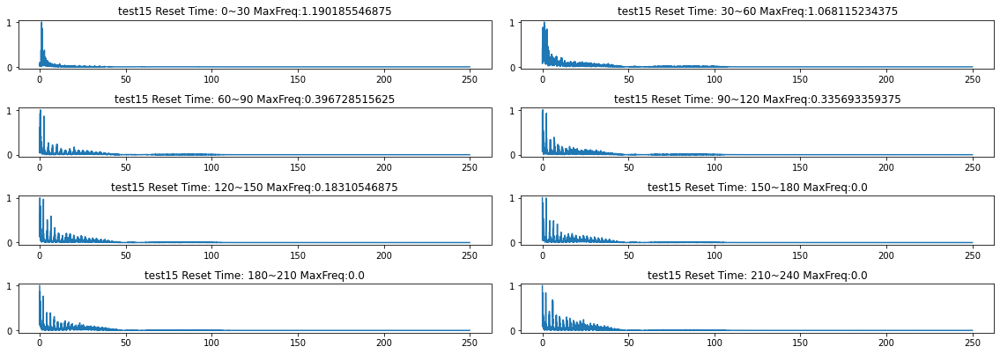

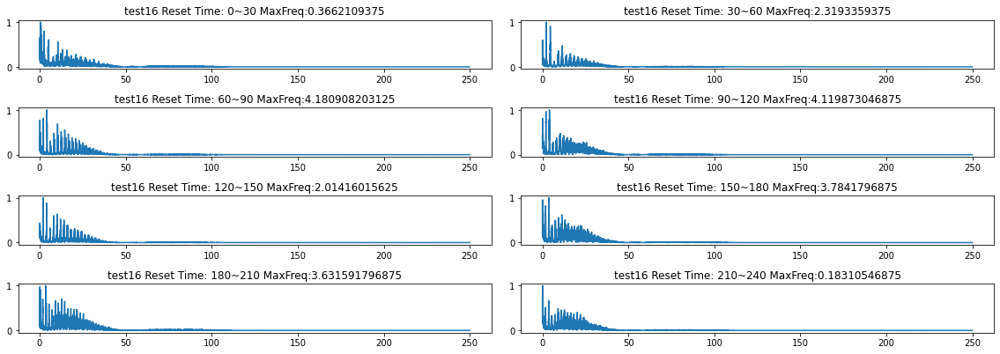

In [13]:
#c = list(map(lambda x :x[0]+x[1] ,zip(a,b)))
data_count = [1,2,3,4,5,9,10,15,16]
a = [(0 for i in range(0,90000)),(0 for i in range(0,90000)),(0 for i in range(0,90000)),(0 for i in range(0,90000)),(0 for i in range(0,90000)),(0 for i in range(0,90000))]
for j in data_count:
    sport_data = ecg_data[j].data_2[:500*180] 
    reset_data = ecg_data[j].data_2[500*180:]
    split_sport = [sport_data[(30*i)*500:(30*(i+1))*500] for i in range(180//30)]
    plt.figure(figsize=(16,11))
    minmax = MinMaxScaler()
    for i in range(len(split_sport)):
        plt.subplot('92{}'.format(i+1))
        Fre, FFT_y1 = fft_freq(split_sport[i])
#        c = list(map(lambda x :x[0]+x[1] ,zip(a[i],FFT_y1)))
        plt.plot(Fre, preprocessing.minmax_scale(FFT_y1 ))
        plt.title('test{} Sport Time: {}~{} MaxFreq:{}'.format(j ,30*i,30*(i+1) ,FFT_y1.argmax()/32.768))
    plt.tight_layout()
    plt.show()
##--------------------------------------------------------------------------------
for j in data_count:
    sport_data = ecg_data[j].data_2[:500*180] 
    reset_data = ecg_data[j].data_2[500*180:]
    split_reset = [reset_data[(30*i)*500:(30*(i+1))*500] for i in range(240//30)]
    plt.figure(figsize=(16,11))
    for i in range(len(split_reset)):
        plt.subplot('82{}'.format(i+1))
        Fre, FFT_y1 = fft_freq(split_reset[i])
        plt.plot(Fre, preprocessing.minmax_scale(FFT_y1 ))
        plt.title('test{} Reset Time: {}~{} MaxFreq:{}'.format(j ,30*i,30*(i+1) ,FFT_y1.argmax()/32.768))
    plt.tight_layout()
##--------------------------------------------------------------------------------

In [17]:

##_標記R波
b, a = signal.butter(3, [5 /250, 15/250], btype='band')
## qrs_i_raw = x, qrs_amp_raw = y
## ecg_h1 = 休息中, ecg_h2 = 運動中
##--------------------------------------------------------------------------------
ecg_filtered = signal.lfilter(b, a, ecg_data[i].data_2[-3*60*250:-2*60*250])
#ecg_h1, qrs_amp_raw, qrs_i_raw, delay = pan_tompkin(ecg_filtered, 500, 0)
ecg_h1, qrs_amp_raw, qrs_i_raw, delay = pan_tompkin(ecg_data[i].data_2[-3*60*250:-2*60*250], 500, 0)
plt.figure(figsize=(24, 5))
plt.plot(ecg_h1) #ECG訊號
#plt.axis([150, 363, -1, 1])
plt.plot(qrs_i_raw, qrs_amp_raw, 'o', color="red") #r波
print(qrs_i_raw)
##--------------------------------------------------------------------------------
ecg_filtered = signal.lfilter(b, a, ecg_data[i].data_2[1*60*250:2*60*250])
#ecg_h2, qrs_amp_raw, qrs_i_raw, delay = pan_tompkin(ecg_filtered, 500, 0)
ecg_h2, qrs_amp_raw, qrs_i_raw, delay = pan_tompkin(ecg_data[i].data_2[1*60*250:2*60*250], 500, 0)
plt.figure(figsize=(24, 5))
plt.plot(ecg_h2) #ECG訊號
#plt.axis([137, 355, -1, 1])
plt.plot(qrs_i_raw, qrs_amp_raw, 'o', color="red") #r波
print(qrs_i_raw)
##--------------------------------------------------------------------------------
#print(ecg_h1[150:363],ecg_h2[137:355])
#plt.figure(figsize=(24, 5))
#plt.plot(ecg_h1[150:363])
#plt.plot(ecg_h2[137:355])
#plt.axis([0, 370, -1, 1])
plt.figure(figsize=(24, 5))
plt.plot(ecg_rest)
plt.plot(ecg_motion)
plt.show

##--------------------------------------------------------------------------------
##插值法
import numpy as np
from scipy import interpolate
import matplotlib.pyplot as plt
#plt.plot(ecg_h1[249:594]) 14881
#plt.plot(ecg_h2[285:563]) 14822
## ecg_h1 = 休息中, ecg_h2 = 運動中

x = np.linspace(151, 372, 221)
y = ecg_motion

f1 = interp1d(x, y, kind = 'linear')
xnew = np.linspace(151, 372, 253)
ynew = f1(xnew)
plt.figure(figsize=(24, 5))
plt.plot(x, y, 'o', xnew, ynew, '--')

ecg_ma = ecg_rest - ynew #運動偽影

plt.figure(figsize=(24, 5))
plt.plot(ecg_ma)
plt.show()


Note: you may need to restart the kernel to use updated packages.


In [ ]:
##__PanTompkin
''' 
Inputs:
ecg_original:raw ecg
fs:sampling rate
gr:flag to plot 1 is plot 0 is not plot

Outputs:
ecg_h:complete high pass
qrs_amp_raw:amplitude of R waves amplitudes
qrs_i_raw:index of R waves
delay:number of samples which the signal is delayed due to the filtering
'''

'''
This function is copy from matlab pan_tompkin function and not made by me
matlab pan_tompkin
https://www.mathworks.com/matlabcentral/fileexchange/45840-complete-pan-tompkins-implementation-ecg-qrs-detector
'''

def pan_tompkin(ecg_original, fs=1000, gr=1):
    delay = 0
    skip = 0
    m_selected_RR = 0
    mean_RR = 0
    ser_back = 0 
    
    if (fs == 200):
        # Low pass and High pass
        # Low pass
        wn = 12 * 2 / fs
        N = 3                                                              
        a, b = signal.butter(N, wn, 'low')
        ecg_l = signal.filtfilt(a, b, ecg_original)
        ecg_l = ecg_l / max(abs(ecg_l))
        ecg_l = np.around(ecg_l, decimals=4)

        # High pass
        wn = 5 * 2 / fs
        N = 3                                          
        a, b = signal.butter(N, wn, 'high')                                        
        ecg_h = signal.filtfilt(a, b, ecg_original) 
        ecg_h = ecg_h / max(abs(ecg_h))

        """"
        plt.title('Low pass')
        plt.figure()
        plt.subplot(211)
        plt.plot(ecg_l)
        plt.subplot(212)
        plt.title('High pass')
        plt.plot(ecg_h)
        """

    else:
        ecg_h = ecg_original
        # Bandpass
        '''
        f1 = 5                                                  
        f2 = 15
        wn = []
        wn.append(f1 * 2 / fs)
        wn.append(f2 * 2 / fs)
        N = 3                                                     
        a, b = signal.butter(N, wn, 'bandpass')                                                  
        ecg_h = signal.filtfilt(a, b, ecg_original)
        ecg_h = ecg_h / max(abs(ecg_h))
        '''

        '''
        plt.figure()
        plt.title('Bandpass')
        plt.plot(ecg_h)
        '''

    # Derivative
    int_c = (5 - 1) / (fs * 1 / 40)
    x = np.arange(1,6)
    xp = np.dot(np.array([1, 2, 0, -2, -1]), (1 / 8) * fs)
    fp = np.arange(1,5+int_c,int_c)
    b = np.interp(fp, x, xp)
    ecg_d = signal.filtfilt(b, 1, ecg_h)
    ecg_d = ecg_d / max(ecg_d)
    '''
    plt.figure()
    plt.title('Derivative')
    plt.plot(ecg_d)
    '''

    # Squaring and Moving average
    ecg_s = np.power(ecg_d, 2)
    ecg_m = np.convolve(ecg_s ,np.ones(int(np.around(0.150*fs)))/np.around(0.150*fs))
    delay = delay + np.around(0.150*fs) / 2

    '''
    plt.figure()
    plt.title('Average')
    plt.plot(ecg_m)
    '''

    # Fiducial Marks
    locs = peakutils.indexes(ecg_m, thres=0, min_dist=np.around(0.2 * fs))
    pks = ecg_m[locs[:]]
    '''
    plt.figure()
    plt.title('Peaks')
    plt.plot(ecg_m)
    plt.plot(locs, ecg_m[locs], "x")
    '''

    # Init other parameters
    LLp = len(pks)
    qrs_c = np.zeros(LLp)
    qrs_i = np.zeros(LLp)
    qrs_i_raw = np.zeros(LLp)
    qrs_amp_raw= np.zeros(LLp)
    nois_c = np.zeros(LLp)
    nois_i = np.zeros(LLp)
    SIGL_buf = np.zeros(LLp)
    NOISL_buf = np.zeros(LLp)
    SIGL_buf1 = np.zeros(LLp)
    NOISL_buf1 = np.zeros(LLp)
    THRS_buf1 = np.zeros(LLp)
    THRS_buf = np.zeros(LLp)

    # Init training phase
    THR_SIG = max(ecg_m[0:2*fs])*1/3
    THR_NOISE = np.mean(ecg_m[0:2*fs])*1/2
    SIG_LEV= THR_SIG
    NOISE_LEV = THR_NOISE


    # Init bandpath filter threshold
    THR_SIG1 = max(ecg_h[0:2*fs])*1/3
    THR_NOISE1 = np.mean(ecg_h[0:2*fs])*1/2
    SIG_LEV1 = THR_SIG1                      
    NOISE_LEV1 = THR_NOISE1

    # Thresholding and desicion rule
    Beat_C = -1
    Beat_C1 = -1
    Noise_Count = 0

    for i in range(LLp):
        if ((locs[i] - np.around(0.150*fs)) >= 1 and (locs[i] <= len(ecg_h))):
            _start = locs[i] - np.around(0.15*fs).astype(int)
            _ = ecg_h[_start:locs[i]]
            y_i = max(_)
            x_i = np.argmax(_)
        else:
            if i == 0:
                y_i = max(ecg_h[0:locs[i]])
                x_i = np.argmax(ecg_h[0:locs[i]])
                ser_back = 1
            elif (locs[i] >= len[ecg_h]):
                _ = ecg_h[locs[i] - np.around(0.150*fs).astype(int):]
                y_i = max(_)
                x_i = np.argmax(_)

        # Update the heart_rate    
        if (Beat_C >= 9):
            diffRR = np.diff(qrs_i[Beat_C-8:Beat_C])
            mean_RR = np.mean(diffRR)
            comp = qrs_i[Beat_C] - qrs_i[Beat_C-1]
            if ((comp <= 0.92*mean_RR) or (comp >= 1.16*mean_RR)):
                THR_SIG = 0.5*(THR_SIG)
                THR_SIG1 = 0.5*(THR_SIG1)               
            else:
                m_selected_RR = mean_RR

        # Calculate the mean last 8 R waves to ensure that QRS is not
        if m_selected_RR:
            test_m = m_selected_RR
        elif (mean_RR and m_selected_RR == 0):
            test_m = mean_RR
        else:
            test_m = 0

        if test_m:
            if ((locs[i] - qrs_i[Beat_C]) >= np.around(1.66*test_m)):
                _start = int(qrs_i[Beat_C] + np.around(0.20*fs))
                _end = int(locs[i] - np.around(0.20*fs))
                pks_temp = max(ecg_m[_start:_end+1])
                locs_temp = np.argmax(ecg_m[_start:_end+1])
                locs_temp = qrs_i[Beat_C] + np.around(0.20*fs) + locs_temp - 1

                if (pks_temp > THR_NOISE):
                    Beat_C += 1
                    qrs_c[Beat_C] = pks_temp
                    qrs_i[Beat_C] = locs_temp

                    if (locs_temp <= len(ecg_h)):
                        _start = int(locs_temp - np.around(0.150*fs))
                        _end = int(locs_temp + 1)
                        y_i_t = max(ecg_h[_start:_end])
                        x_i_t = np.argmax(ecg_h[_start:_end])
                    else:
                        _ = locs_temp - np.around(0.150*fs)
                        y_i_t = max(ecg_h[_:])
                        x_i_t = np.argmax(ecg_h[_:])

                    if (y_i_t > THR_NOISE1):
                        Beat_C1 += 1
                        qrs_i_raw[Beat_C1] = locs_temp - np.around(0.150*fs) + (x_i_t - 1)
                        qrs_amp_raw[Beat_C1] = y_i_t
                        SIG_LEV1 = 0.25*y_i_t + 0.75*SIG_LEV1

                    not_nois = 1
                    SIG_LEV = 0.25*pks_temp + 0.75*SIG_LEV       
            else:
                not_nois = 0

        # Find noise and QRS peaks
        if (pks[i] >= THR_SIG): 
            if (Beat_C >= 3):
                if ((locs[i] - qrs_i[Beat_C]) <= np.around(0.3600*fs)):
                    _start = locs[i] - np.around(0.075*fs).astype('int')
                    Slope1 = np.mean(np.diff(ecg_m[_start:locs[i]]))
                    _start = int(qrs_i[Beat_C] - np.around(0.075*fs))
                    _end = int(qrs_i[Beat_C])
                    Slope2 = np.mean(np.diff(ecg_m[_start:_end]))
                    if abs(Slope1) <= abs(0.5*(Slope2)):
                        nois_c[Noise_Count] = pks[i]
                        nois_i[Noise_Count] = locs[i]
                        Noise_Count += 1
                        skip = 1
                        NOISE_LEV1 = 0.125*y_i + 0.875*NOISE_LEV1
                        NOISE_LEV = 0.125*pks[i] + 0.875*NOISE_LEV
                    else:
                        skip = 0

            if (skip == 0):
                Beat_C += 1
                qrs_c[Beat_C] = pks[i]
                qrs_i[Beat_C] = locs[i]

                if (y_i >= THR_SIG1):
                    Beat_C1 += 1
                    if ser_back:
                        qrs_i_raw[Beat_C1] = x_i
                    else:
                        qrs_i_raw[Beat_C1] = locs[i] - np.around(0.150*fs) + (x_i - 1)

                    qrs_amp_raw[Beat_C1] =  y_i
                    SIG_LEV1 = 0.125*y_i + 0.875*SIG_LEV1

                SIG_LEV = 0.125*pks[i] + 0.875*SIG_LEV

        elif ((THR_NOISE <= pks[i]) and (pks[i] < THR_SIG)):
            NOISE_LEV1 = 0.125*y_i + 0.875*NOISE_LEV1
            NOISE_LEV = 0.125*pks[i] + 0.875*NOISE_LEV     
        elif (pks[i] < THR_NOISE):
            nois_c[Noise_Count] = pks[i]
            nois_i[Noise_Count] = locs[i]    
            NOISE_LEV1 = 0.125*y_i + 0.875*NOISE_LEV1    
            NOISE_LEV = 0.125*pks[i] + 0.875*NOISE_LEV
            Noise_Count += 1

        # Adjust the threshold with SNR
        if (NOISE_LEV != 0 or SIG_LEV != 0):
            THR_SIG = NOISE_LEV + 0.25*(abs(SIG_LEV - NOISE_LEV))
            THR_NOISE = 0.5*(THR_SIG)

        if (NOISE_LEV1 != 0 or SIG_LEV1 != 0):
            THR_SIG1 = NOISE_LEV1 + 0.25*(abs(SIG_LEV1 - NOISE_LEV1))
            THR_NOISE1 = 0.5*(THR_SIG1)

        SIGL_buf[i] = SIG_LEV
        NOISL_buf[i] = NOISE_LEV
        THRS_buf[i] = THR_SIG

        SIGL_buf1[i] = SIG_LEV1
        NOISL_buf1[i] = NOISE_LEV1
        THRS_buf1[i] = THR_SIG1

        skip = 0                                                  
        not_nois = 0
        ser_back = 0

    # Adjust lengths
    qrs_i_raw = qrs_i_raw[0:Beat_C1+1]
    qrs_amp_raw = qrs_amp_raw[0:Beat_C1+1]
    qrs_c = qrs_c[0:Beat_C+1]
    qrs_i = qrs_i[0:Beat_C+1]
    
    if (gr == 1):
        plt.figure()
        plt.plot(ecg_m)
        plt.plot(qrs_i, qrs_c, 'o', color='red')
    return ecg_h, qrs_amp_raw, qrs_i_raw, delay